# Rainfall Weather Forecasting

# Project Description

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.


Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, predict two things:
 
 
1. Problem Statement: 

a) Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.


b)  Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there


Dataset Description:
Number of columns: 23


Date  - The date of observation


Location  -The common name of the location of the weather station


MinTemp  -The minimum temperature in degrees celsius


MaxTemp -The maximum temperature in degrees celsius


Rainfall  -The amount of rainfall recorded for the day in mm


Evaporation  -The so-called Class A pan evaporation (mm) in the 24 hours to 9am


Sunshine  -The number of hours of bright sunshine in the day.


WindGustDi r- The direction of the strongest wind gust in the 24 hours to midnight


WindGustSpeed -The speed (km/h) of the strongest wind gust in the 24 hours to midnight


WindDir9am -Direction of the wind at 9am


WindDir3pm -Direction of the wind at 3pm


WindSpeed9am -Wind speed (km/hr) averaged over 10 minutes prior to 9am


WindSpeed3pm -Wind speed (km/hr) averaged over 10 minutes prior to 3pm


Humidity9am -Humidity (percent) at 9am


Humidity3pm -Humidity (percent) at 3pm


Pressure9am -Atmospheric pressure (hpa) reduced to mean sea level at 9am


Pressure3pm -Atmospheric pressure (hpa) reduced to mean sea level at 3pm


Cloud9am - Fraction of sky obscured by cloud at 9am. 


Cloud3pm -Fraction of sky obscured by cloud 


Temp9am-Temperature (degrees C) at 9am


Temp3pm -Temperature (degrees C) at 3pm


RainToday -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0

    
RainTomorrow -The amount of next day rain in mm. Used to create response variable . A kind of measure of the "risk".



# Importing Libraries

In [259]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
import warnings
warnings.filterwarnings('ignore')

# Importing Dataset

In [260]:
df=pd.read_csv('weatherAUS.csv')
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


In [261]:
df.shape

(8425, 23)

This data has 8425 rows and 23 columns

In [262]:
df.head(10)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
5,2008-12-06,Albury,14.6,29.7,0.2,NaN,NaN,WNW,56.0,W,...,55.0,23.0,1009.2,1005.4,NaN,NaN,20.6,28.9,No,No
6,2008-12-07,Albury,14.3,25.0,0.0,NaN,NaN,W,50.0,SW,...,49.0,19.0,1009.6,1008.2,1.0,NaN,18.1,24.6,No,No
7,2008-12-08,Albury,7.7,26.7,0.0,NaN,NaN,W,35.0,SSE,...,48.0,19.0,1013.4,1010.1,NaN,NaN,16.3,25.5,No,No
8,2008-12-09,Albury,9.7,31.9,0.0,NaN,NaN,NNW,80.0,SE,...,42.0,9.0,1008.9,1003.6,NaN,NaN,18.3,30.2,No,Yes
9,2008-12-10,Albury,13.1,30.1,1.4,NaN,NaN,W,28.0,S,...,58.0,27.0,1007.0,1005.7,NaN,NaN,20.1,28.2,Yes,No


Top 10 rows of the the dataset

In [263]:
df.tail(10)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
8415,2017-06-16,Uluru,5.2,24.3,0.0,NaN,NaN,E,24.0,SE,...,53.0,24.0,1023.8,1020.0,NaN,NaN,12.3,23.3,No,No
8416,2017-06-17,Uluru,6.4,23.4,0.0,NaN,NaN,ESE,31.0,S,...,53.0,25.0,1025.8,1023.0,NaN,NaN,11.2,23.1,No,No
8417,2017-06-18,Uluru,8.0,20.7,0.0,NaN,NaN,ESE,41.0,SE,...,56.0,32.0,1028.1,1024.3,NaN,7.0,11.6,20.0,No,No
8418,2017-06-19,Uluru,7.4,20.6,0.0,NaN,NaN,E,35.0,ESE,...,63.0,33.0,1027.2,1023.3,NaN,NaN,11.0,20.3,No,No
8419,2017-06-20,Uluru,3.5,21.8,0.0,NaN,NaN,E,31.0,ESE,...,59.0,27.0,1024.7,1021.2,NaN,NaN,9.4,20.9,No,No
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
8424,2017-06-25,Uluru,14.9,NaN,0.0,NaN,NaN,NaN,NaN,ESE,...,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,NaN


Last 10 rows of the dataset

In [264]:
df.sample(20)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
2239,2015-05-31,Newcastle,13.2,15.7,4.0,NaN,NaN,NaN,NaN,NaN,...,88.0,89.0,NaN,NaN,8.0,8.0,14.3,14.4,Yes,Yes
4368,2009-02-18,Wollongong,18.3,24.8,16.8,NaN,NaN,SSW,63.0,SSW,...,93.0,68.0,1010.8,1008.6,8.0,5.0,20.4,23.6,Yes,No
3319,2017-02-28,Williamtown,18.4,26.1,11.0,NaN,NaN,SSE,37.0,WSW,...,89.0,74.0,1021.6,1019.9,4.0,8.0,21.5,24.7,Yes,Yes
1625,2013-09-24,Newcastle,14.6,31.2,0.0,NaN,NaN,NaN,NaN,NaN,...,60.0,22.0,NaN,NaN,8.0,4.0,17.8,30.5,No,No
2919,2016-01-25,Williamtown,19.5,27.2,0.2,22.6,6.7,ESE,39.0,ESE,...,64.0,60.0,1014.0,1012.6,7.0,5.0,25.3,26.9,No,No
5683,2010-09-22,Melbourne,9.8,16.6,0.0,0.8,1.2,SSE,33.0,S,...,64.0,53.0,1028.2,1026.4,7.0,7.0,12.9,14.7,No,No
3423,2017-06-12,Williamtown,10.1,20.2,1.8,NaN,NaN,SE,22.0,NW,...,100.0,66.0,1024.6,1023.0,8.0,NaN,12.9,19.2,Yes,Yes
6762,2014-07-12,Adelaide,5.8,13.5,1.6,NaN,NaN,SSE,31.0,NaN,...,81.0,71.0,1027.5,1028.3,NaN,NaN,9.3,10.9,Yes,No
793,2011-02-02,Albury,21.9,33.7,0.0,NaN,NaN,NNE,41.0,NNE,...,77.0,49.0,1014.1,1011.1,NaN,NaN,25.4,32.0,No,Yes
2827,2015-10-25,Williamtown,10.8,27.8,24.8,18.0,10.2,ENE,35.0,NaN,...,71.0,37.0,1022.2,1018.0,2.0,2.0,19.3,27.4,Yes,No


Random sample of 20 rows of data

# Exploratory data analysis 

In [265]:
df.columns.to_list()

['Date',
 'Location',
 'MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustDir',
 'WindGustSpeed',
 'WindDir9am',
 'WindDir3pm',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm',
 'RainToday',
 'RainTomorrow']

List of all the columns present in the dataset

# Checking for data types present in each column

In [266]:
df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

This dataset contains two type of data ['object','float64']. There total 7 columns with object type data and 16 columns with float64 type data which numerical data

# Checking for white space

In [267]:
has_white_space= ' ' in df
has_white_space

False

There are no white space present in the dataset.

# Checking for duplicate  value

In [268]:
df.duplicated().sum()

1663

There are total 1663 duplicate values present in the dataset which we have to remove 

In [269]:
df=df.drop_duplicates()

Drop all the duplicate values from the dataset 

In [270]:
df.duplicated().sum()

0

In [271]:
df.shape

(6762, 23)

After droping all the duplicate values we can again check for it and we can see that now there are no duplicated values present in the dataset. eariler there are 8425 rows in the dataset now there are 6762 rows present in the dataset after removing duplicate values

# Checking for various symbols in the dataset

In [272]:
df.isin([' ?']).sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

'?' symbol is not present in the dataset

In [273]:
df.isin(['@']).sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

'@' symbol is not present in the dataset

In [274]:
df.isin(['#']).sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

'#' symbol is not present in the dataset

In [275]:
df.isin(['~']).sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

'~' symbol is not present in the dataset

In [276]:
df.isin(['*']).sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

'*' symbol is not present in the dataset

# Checking for null values

In [277]:
df.isnull().sum()

Date                0
Location            0
MinTemp            70
MaxTemp            57
Rainfall          138
Evaporation      2921
Sunshine         3236
WindGustDir       942
WindGustSpeed     942
WindDir9am        794
WindDir3pm        294
WindSpeed9am       63
WindSpeed3pm      100
Humidity9am        54
Humidity3pm        96
Pressure9am      1308
Pressure3pm      1311
Cloud9am         1866
Cloud3pm         1902
Temp9am            51
Temp3pm            92
RainToday         138
RainTomorrow      138
dtype: int64

As we can see that null values are present in the dataset. and we have to treat them 

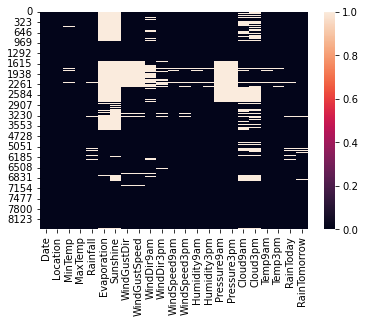

In [278]:
#visualization with heatmap for null values
sns.heatmap(df.isnull())
plt.show()

Here we can see in heatmap visualization that null values are present in the dataset, white color is showing prescence of null value values

In [279]:
#Treating null values for contineous columns 
df["MinTemp"] = df["MinTemp"].fillna(df["MinTemp"].median())
df["MaxTemp"] = df["MaxTemp"].fillna(df["MaxTemp"].median())
df["Rainfall"] = df["Rainfall"].fillna(df["Rainfall"].median())
df["Evaporation"] = df["Evaporation"].fillna(df["Evaporation"].median())
df["Sunshine"] = df["Sunshine"].fillna(df["Sunshine"].median())
df["WindGustSpeed"] = df["WindGustSpeed"].fillna(df["WindGustSpeed"].mean())
df["WindSpeed9am"] = df["WindSpeed9am"].fillna(df["WindSpeed9am"].mean())
df["WindSpeed3pm"] = df["WindSpeed3pm"].fillna(df["WindSpeed3pm"].mean())
df["Humidity9am"] = df["Humidity9am"].fillna(df["Humidity9am"].mean())
df["Humidity3pm"] = df["Humidity3pm"].fillna(df["Humidity3pm"].mean())
df["Pressure9am"] = df["Pressure9am"].fillna(df["Pressure9am"].mean())
df["Pressure3pm"] = df["Pressure3pm"].fillna(df["Pressure3pm"].mean())
df["Cloud9am"] = df["Cloud9am"].fillna(df["Cloud9am"].mean())
df["Cloud3pm"] = df["Cloud3pm"].fillna(df["Cloud3pm"].mean())
df["Temp9am"] = df["Temp9am"].fillna(df["Temp9am"].mean())
df["Temp3pm"] = df["Temp3pm"].fillna(df["Temp3pm"].mean())

In [280]:
#Treating null values for categorical columns
df['WindGustDir'] = df['WindGustDir'].fillna(df['WindGustDir'].mode()[0])
df['WindDir9am'] = df['WindDir9am'].fillna(df['WindDir9am'].mode()[0])
df['WindDir3pm'] = df['WindDir3pm'].fillna(df['WindDir3pm'].mode()[0])
df['RainToday'] = df['RainToday'].fillna(df['RainToday'].mode()[0])
df['RainTomorrow']=df['RainTomorrow'].fillna(df['RainTomorrow'].mode()[0])

Again check for prescence of null values

In [281]:
df.isnull().sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

We can see that null values are removed from the dataset

<AxesSubplot:>

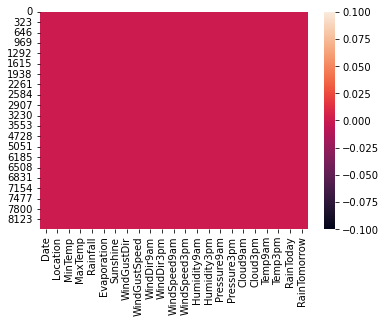

In [282]:
#Visualization by heatmap
sns.heatmap(df.isnull())

There are no null values present in the dataset.

In [283]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6762 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           6762 non-null   object 
 1   Location       6762 non-null   object 
 2   MinTemp        6762 non-null   float64
 3   MaxTemp        6762 non-null   float64
 4   Rainfall       6762 non-null   float64
 5   Evaporation    6762 non-null   float64
 6   Sunshine       6762 non-null   float64
 7   WindGustDir    6762 non-null   object 
 8   WindGustSpeed  6762 non-null   float64
 9   WindDir9am     6762 non-null   object 
 10  WindDir3pm     6762 non-null   object 
 11  WindSpeed9am   6762 non-null   float64
 12  WindSpeed3pm   6762 non-null   float64
 13  Humidity9am    6762 non-null   float64
 14  Humidity3pm    6762 non-null   float64
 15  Pressure9am    6762 non-null   float64
 16  Pressure3pm    6762 non-null   float64
 17  Cloud9am       6762 non-null   float64
 18  Cloud3pm

Here we can see the general information about the dataset that this data set has 6762 non null values, this dataset contains object & float64 type dataset and using 1.2mb from the memory 

# Checking for uniques values present in each column

In [284]:
df.nunique()

Date             3004
Location           12
MinTemp           285
MaxTemp           331
Rainfall          250
Evaporation       116
Sunshine          140
WindGustDir        16
WindGustSpeed      53
WindDir9am         16
WindDir3pm         16
WindSpeed9am       35
WindSpeed3pm       36
Humidity9am        91
Humidity3pm        95
Pressure9am       385
Pressure3pm       375
Cloud9am           10
Cloud3pm           10
Temp9am           305
Temp3pm           329
RainToday           2
RainTomorrow        2
dtype: int64

Here we can see count for unique values present in each columns in the dataset

# checking for Unique values present in the target column

In [285]:
#Checking number of unique values in target column
df['RainTomorrow'].nunique()

2

In [286]:
df['RainTomorrow'].unique()

array(['No', 'Yes'], dtype=object)

There are only two variable in RainTomorrow column so we will use binary classification.

In [287]:
#Checking number of unique values in target column
df['Rainfall'].nunique()

250

There are 250 unique value present in the Rainfall column 

# Correct date column in datetime format

In [288]:
#Now We will convert date from object type to date type and then seperate day, month and year
df['Date']=pd.to_datetime(df['Date'])
df["Day"] = df['Date'].dt.day
df["Month"] = df['Date'].dt.month
df["Year"] = df['Date'].dt.year

In [289]:
# Now Drop the date as we have already got Day,month and year
df.drop("Date",axis=1,inplace=True)

In [290]:
df.shape

(6762, 25)

In [291]:
df.sample(10)

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
7668,PerthAirport,17.1,28.5,0.0,10.4,12.0,W,37.000000,NW,W,...,1006.000000,1.000000,1.000000,22.1,26.7,No,No,2,3,2013
4950,Melbourne,16.4,25.0,28.8,5.4,9.7,SW,31.000000,SSW,NNE,...,1007.000000,4.000000,7.000000,19.2,23.2,Yes,Yes,9,12,2010
6904,Adelaide,17.5,24.6,0.0,20.0,9.0,W,31.000000,W,WSW,...,1009.100000,4.336806,4.320988,18.7,22.8,No,No,1,12,2014
6931,Adelaide,13.3,30.4,0.0,4.6,9.0,W,30.000000,NNW,WSW,...,1010.300000,4.336806,4.320988,21.5,29.3,No,Yes,28,12,2014
6866,Adelaide,14.0,33.1,0.0,3.8,9.0,SSW,30.000000,NE,SW,...,1012.900000,4.336806,4.320988,22.1,31.7,No,No,24,10,2014
2825,Williamtown,14.7,21.4,0.0,4.6,9.0,S,59.000000,WSW,SSW,...,1020.900000,7.000000,5.000000,15.6,20.3,No,No,23,10,2015
6681,Brisbane,5.4,22.5,0.0,4.4,10.2,ENE,19.000000,SW,SSW,...,1017.100000,0.000000,0.000000,13.8,22.1,No,No,4,8,2012
1641,Newcastle,13.8,34.4,0.0,4.6,9.0,E,38.977663,NW,NW,...,1015.119923,0.000000,0.000000,23.5,33.8,No,No,10,10,2013
8015,PerthAirport,20.3,33.7,0.0,11.8,11.1,E,52.000000,E,ESE,...,1005.600000,5.000000,5.000000,24.6,32.2,No,No,12,2,2014
3442,Wollongong,18.6,32.5,0.2,4.6,9.0,SSE,44.000000,SE,SSE,...,1004.400000,4.336806,4.000000,27.6,21.2,No,No,6,12,2008


Here we can see that we got day month year column from date column and we have drop the date column after getting day, month and year columns

In [292]:
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Day,Month,Year
count,6762.000000,6762.000000,6762.000000,6762.00000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000
mean,13.110086,24.093301,2.723410,4.99898,8.421665,38.977663,12.782206,17.571150,67.506559,50.467147,1017.626311,1015.119923,4.336806,4.320988,17.895038,22.708561,15.737208,6.462141,2012.052203
std,5.540674,6.130367,10.490138,3.36177,2.789228,13.376457,9.787577,9.548634,17.182700,18.498341,6.027914,5.967638,2.474649,2.323276,5.722411,5.971845,8.793898,3.377471,2.301057
min,-2.000000,8.200000,0.000000,0.00000,0.000000,7.000000,0.000000,0.000000,10.000000,6.000000,989.800000,982.900000,0.000000,0.000000,1.900000,7.300000,1.000000,1.000000,2008.000000
25%,9.000000,19.600000,0.000000,4.00000,8.800000,30.000000,6.000000,11.000000,56.000000,38.000000,1014.200000,1011.500000,2.000000,3.000000,13.900000,18.400000,8.000000,4.000000,2010.000000
50%,13.200000,23.500000,0.000000,4.60000,9.000000,38.977663,11.000000,17.000000,68.000000,50.000000,1017.626311,1015.119923,4.336806,4.320988,17.900000,22.300000,16.000000,6.000000,2012.000000
75%,17.400000,28.400000,0.800000,5.00000,9.200000,46.000000,19.000000,24.000000,80.000000,62.000000,1020.900000,1018.400000,7.000000,6.000000,22.200000,26.800000,23.000000,9.000000,2014.000000
max,28.500000,45.500000,371.000000,145.00000,13.900000,107.000000,63.000000,83.000000,100.000000,99.000000,1039.000000,1036.000000,8.000000,8.000000,39.400000,44.100000,31.000000,12.000000,2017.000000


### Observations

1. The count for each column is 6762 which means that there are no null value present in the dataset.


2. There is a huge difference between 75th percentile and max value so we can say that outliers are present in the dataset.


3. mean is almost equals to median so there may be prescence of skewness in the dataset.


4. Along with it we can also observe std, 25th,50th,75th percentile value for each of the column 

# Seprating categorical column & Numerical column

### categorical columns

In [293]:
# Separating categorical columns
categorical_columns=[]
for i in df.dtypes.index:
    if df.dtypes[i]=='object':
        categorical_columns.append(i)
print(categorical_columns)

['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


### Numerical columns

In [294]:
# Separating numerical columns
numerical_columns=[]
for i in df.dtypes.index:
    if df.dtypes[i]!='object':
        numerical_columns.append(i)
print(numerical_columns)


['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Day', 'Month', 'Year']


# Data Visualization

### Univarient analysis

##### Numerical Columns

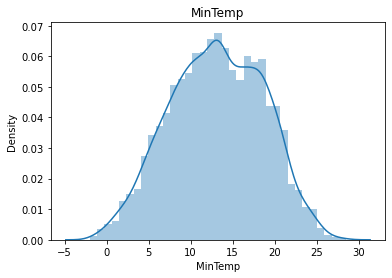

In [295]:
sns.distplot(df['MinTemp'])
plt.title('MinTemp')
plt.show()

In [296]:
df['MinTemp'].mean()

13.110085773439822

The avg. min temp is 13 in MinTemp column in (degree centrigate)

In [297]:
df['MinTemp'].max()

28.5

The max temp. is 28.5 in MinTemp column

In [298]:
df['MinTemp'].min()

-2.0

The min temp is -2 in MinTemp column

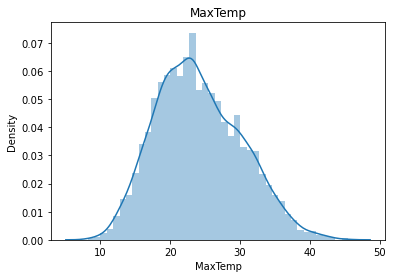

In [299]:
sns.distplot(df['MaxTemp'])
plt.title('MaxTemp')
plt.show()

In [300]:
df['MaxTemp'].min()

8.2

In [301]:
df['MaxTemp'].max()

45.5

In [302]:
df['MaxTemp'].mean()

24.093300798580287

For MaxTemp column avg. temp. is 24 and max temp is 45.5 and min temp is 8.2 in(degree centrigate)

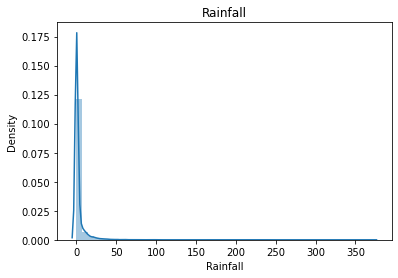

In [303]:
sns.distplot(df['Rainfall'])
plt.title('Rainfall')
plt.show()

In [304]:
df['Rainfall'].min()

0.0

In [305]:
df['Rainfall'].max()

371.0

In [306]:
df['Rainfall'].mean()

2.723410233658698

In Rainfall column mean rainfall is 2.72 max rainfall is 371 and min. rainfall is 0 in(mm)

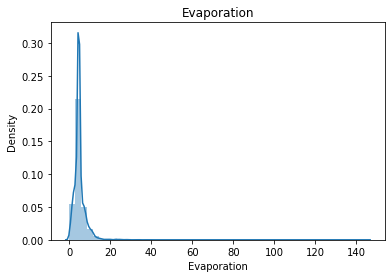

In [307]:
sns.distplot(df['Evaporation'])
plt.title('Evaporation')
plt.show()

In [308]:
df['Evaporation'].min()

0.0

In [309]:
df['Evaporation'].max()

145.0

In [310]:
df['Evaporation'].mean()

4.99897959183674

In Evaporation Column max value is 145 and min value 0 and avg is 4.99 which approximately 5 (mm)

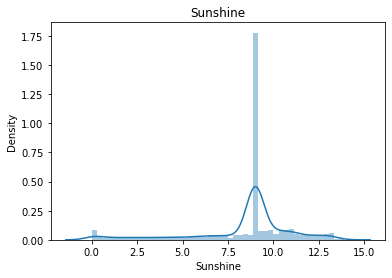

In [311]:
sns.distplot(df['Sunshine'])
plt.title('Sunshine')
plt.show()

In [312]:
df['Sunshine'].mean()

8.421665187814233

In [313]:
df['Sunshine'].max()

13.9

In [314]:
df['Sunshine'].min()

0.0

The avg. sunshine of a day is 8.42 max sunshine is 13.9 and min sunshine is 0 

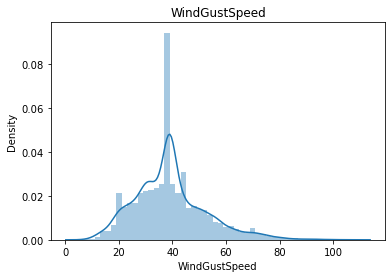

In [315]:
sns.distplot(df['WindGustSpeed'])
plt.title('WindGustSpeed')
plt.show()

In [316]:
df['WindGustSpeed'].max()

107.0

In [317]:
df['WindGustSpeed'].mean()

38.97766323024024

In [318]:
df['WindGustSpeed'].min()

7.0

Avg. WindGustSpeed is 38.97 approx. 39 and min value is 7 and max value is 107 

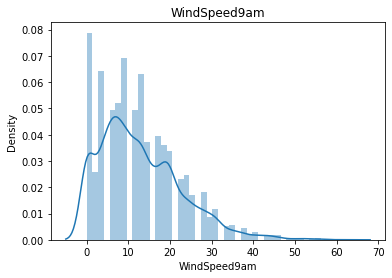

In [319]:
sns.distplot(df['WindSpeed9am'])
plt.title('WindSpeed9am')
plt.show()

In [320]:
df['WindSpeed9am'].max()

63.0

In [321]:
df['WindSpeed9am'].mean()

12.78220629944769

In [322]:
df['WindSpeed9am'].min()

0.0

Avg. Windspeed9am is 12.78 approx 13 and max windspeed9am is 63 and min is 0.

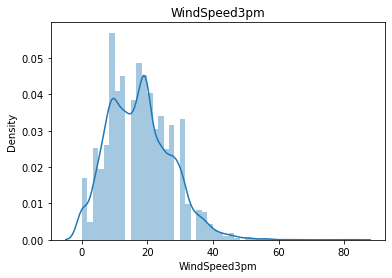

In [323]:
sns.distplot(df['WindSpeed3pm'])
plt.title('WindSpeed3pm')
plt.show()

In [324]:
df['WindSpeed3pm'].mean()

17.57114980486339

In [325]:
df['WindSpeed3pm'].max()

83.0

In [326]:
df['WindSpeed3pm'].min()

0.0

Avg. WindSpeed3pm is 17.57 approx. 18 max WindSpeed3pm is 83 and min is 0.

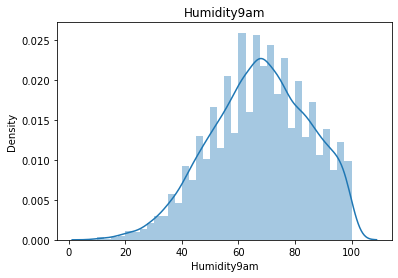

In [327]:
sns.distplot(df['Humidity9am'])
plt.title('Humidity9am')
plt.show()

In [328]:
df['Humidity9am'].mean()

67.50655933214068

In [329]:
df['Humidity9am'].max()

100.0

In [330]:
df['Humidity9am'].min()

10.0

Avg. Humidity9am is 67.50 approx. 68 and max is 100 and min is 10. 

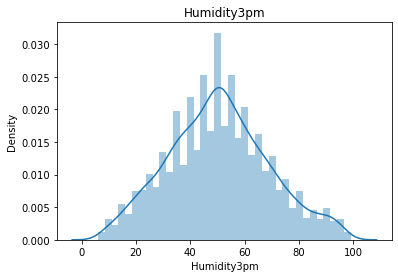

In [331]:
sns.distplot(df['Humidity3pm'])
plt.title('Humidity3pm')
plt.show()

In [332]:
df['Humidity3pm'].mean()

50.46714671467145

In [333]:
df['Humidity3pm'].max()

99.0

In [334]:
df['Humidity3pm'].min()

6.0

Avg. Humidity3pm is 50.46 approx. 51 max is 99 and min is 6.

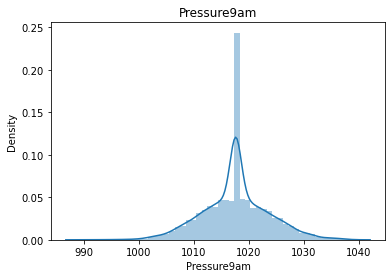

In [335]:
sns.distplot(df['Pressure9am'])
plt.title('Pressure9am')
plt.show()

In [336]:
df['Pressure9am'].mean()

1017.626310964438

In [337]:
df['Pressure9am'].min()

989.8

In [338]:
df['Pressure9am'].max()

1039.0

Avg. Pressure9am is 1017.62 approx 1018 and max is 1039 and min is 989.8

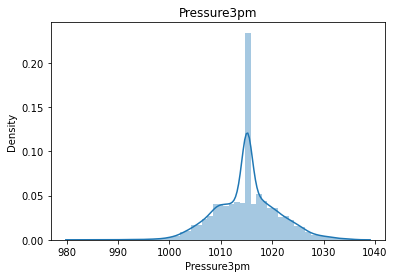

In [339]:
sns.distplot(df['Pressure3pm'])
plt.title('Pressure3pm')
plt.show()

In [340]:
df['Pressure3pm'].mean()

1015.1199229499186

In [341]:
df['Pressure3pm'].max()

1036.0

In [342]:
df['Pressure3pm'].min()

982.9

Avg. Pressure3pm is 1015.11 approx 1015 max Pressure3pm is 1036 and min Pressure3pm is 982.9 

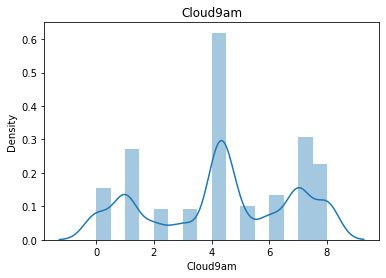

In [343]:
sns.distplot(df['Cloud9am'])
plt.title('Cloud9am')
plt.show()

In [344]:
df['Cloud9am'].mean()

4.336805555555406

In [345]:
df['Cloud9am'].max()

8.0

In [346]:
df['Cloud9am'].min()

0.0

Avg. Cloud9am is 4.33 approx 4, max Cloud9am is 8 and min is 0.

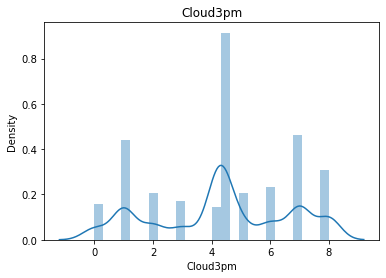

In [347]:
sns.distplot(df['Cloud3pm'])
plt.title('Cloud3pm')
plt.show()

In [348]:
df['Cloud3pm'].mean()

4.3209876543210255

In [349]:
df['Cloud3pm'].min()

0.0

In [350]:
df['Cloud3pm'].max()

8.0

Avg. Cloud3pm is 4.32 approx 4 , min Cloud3pm is 0 and max is 8.

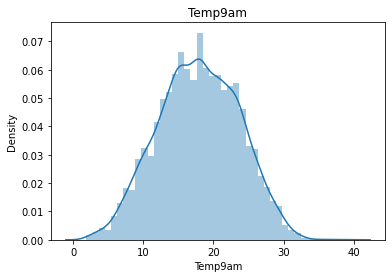

In [351]:
sns.distplot(df['Temp9am'])
plt.title('Temp9am')
plt.show()

In [352]:
df['Temp9am'].mean()

17.895037997317857

In [353]:
df['Temp9am'].max()

39.4

In [354]:
df['Temp9am'].min()

1.9

Avg. Temp9am is 17.85 approx. 18, max Temp9am is 39.4 and min Temp9am is 1.9 

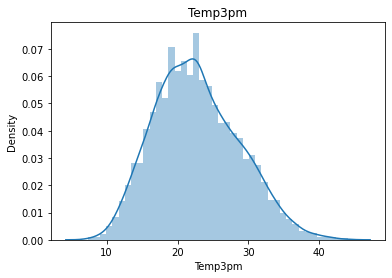

In [355]:
sns.distplot(df['Temp3pm'])
plt.title('Temp3pm')
plt.show()

In [356]:
df['Temp3pm'].mean()

22.70856071964022

In [357]:
df['Temp3pm'].max()

44.1

In [358]:
df['Temp3pm'].min()

7.3

Avg. Temp3pm is 22.70 approx. 23, max Temp3pm is 44.1 and min Temp3pm is 7.3.

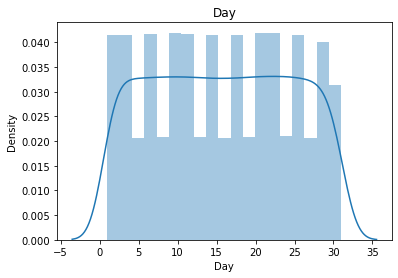

In [359]:
sns.distplot(df['Day'])
plt.title('Day')
plt.show()

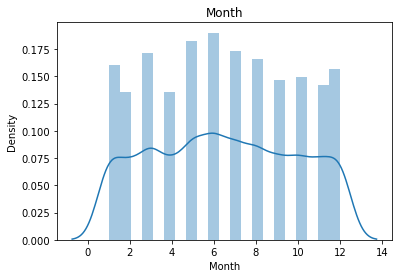

In [360]:
sns.distplot(df['Month'])
plt.title('Month')
plt.show()

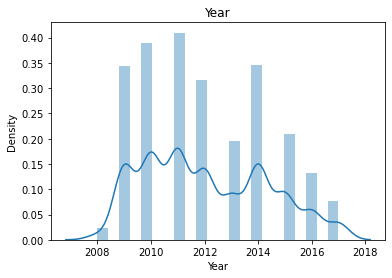

In [361]:
sns.distplot(df['Year'])
plt.title('Year')
plt.show()

##### Categorical columns

In [362]:
categorical_columns

['Location',
 'WindGustDir',
 'WindDir9am',
 'WindDir3pm',
 'RainToday',
 'RainTomorrow']

value count PerthAirport    1204
Albury           907
Newcastle        822
Melbourne        811
Williamtown      615
CoffsHarbour     611
Brisbane         579
Penrith          482
Darwin           250
Wollongong       237
Adelaide         205
Uluru             39
Name: Location, dtype: int64


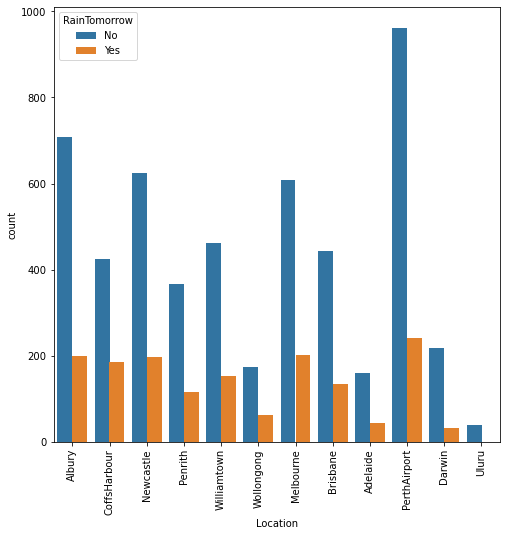

In [363]:
plt.figure(figsize=(8,8))
value=df['Location'].value_counts()
print('value count',value)
sns.countplot(df['Location'],hue=df['RainTomorrow'])
plt.xticks(rotation=90)
plt.show()

We can see that the maximum count is of PerthAirport and Probability of maximum rainfall for tomorrow seems to be max for perthAirport. Uluru has the least count and rainfall for tommorrow dont seem for this place

value count PerthAirport    1204
Albury           907
Newcastle        822
Melbourne        811
Williamtown      615
CoffsHarbour     611
Brisbane         579
Penrith          482
Darwin           250
Wollongong       237
Adelaide         205
Uluru             39
Name: Location, dtype: int64


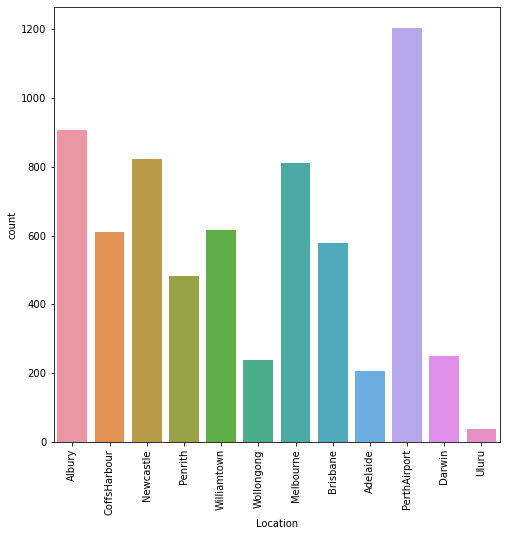

In [364]:
plt.figure(figsize=(8,8))
value=df['Location'].value_counts()
print('value count',value)
sns.countplot(df['Location'])
plt.xticks(rotation=90)
plt.show()

PerthAirport has max rainfall and uluru has minimum

value count E      1460
SW      465
N       459
W       434
WSW     420
WNW     398
SSE     390
S       376
SE      370
ENE     357
NE      300
SSW     299
NW      296
NNE     287
ESE     267
NNW     184
Name: WindGustDir, dtype: int64


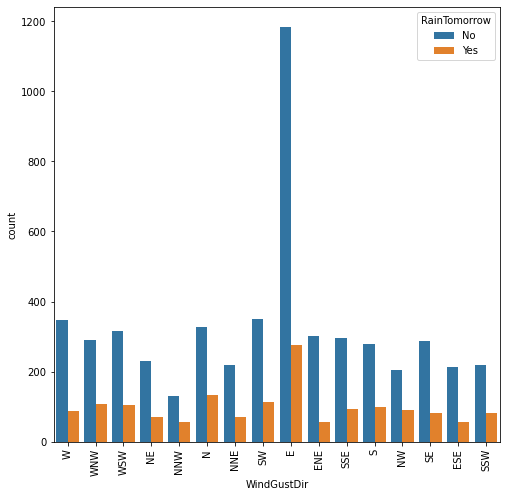

In [365]:
plt.figure(figsize=(8,8))
value=df['WindGustDir'].value_counts()
print('value count',value)
sns.countplot(df['WindGustDir'],hue=df['RainTomorrow'])
plt.xticks(rotation=90)
plt.show()

We can see that the maximum count of 'E' direction and the probability to rain tomorrow is also from 'E' Direction and the least of both is from NNW.

value count E      1460
SW      465
N       459
W       434
WSW     420
WNW     398
SSE     390
S       376
SE      370
ENE     357
NE      300
SSW     299
NW      296
NNE     287
ESE     267
NNW     184
Name: WindGustDir, dtype: int64


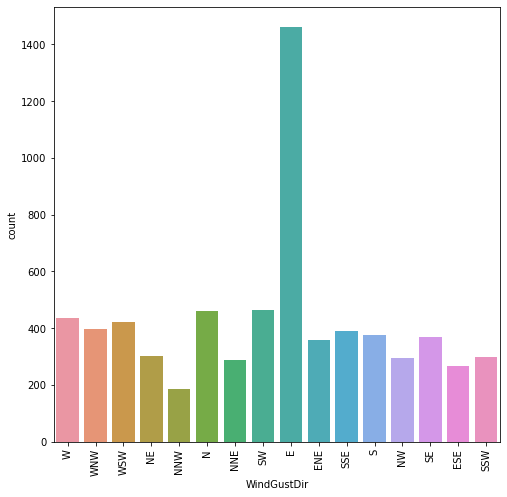

In [366]:
plt.figure(figsize=(8,8))
value=df['WindGustDir'].value_counts()
print('value count',value)
sns.countplot(df['WindGustDir'])
plt.xticks(rotation=90)
plt.show()

WindGustDir is maximum at direction 'E' & minimum at direction 'NNW'

value count N      1403
SW      590
NW      463
SE      439
ENE     397
WSW     394
SSW     368
NE      364
E       338
NNE     337
S       324
WNW     301
SSE     300
W       299
ESE     229
NNW     216
Name: WindDir9am, dtype: int64


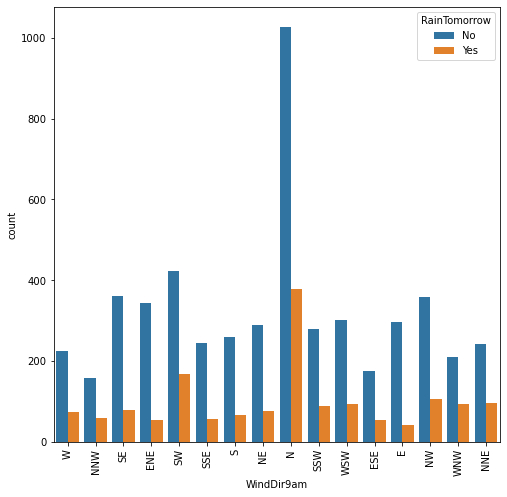

In [367]:
plt.figure(figsize=(8,8))
value=df['WindDir9am'].value_counts()
print('value count',value)
sns.countplot(df['WindDir9am'],hue=df['RainTomorrow'])
plt.xticks(rotation=90)
plt.show()

We can see that the maximum count of 'N' direction and the probability to rain tomorrow is also from 'N' Direction and the least of both is from NNW.

value count N      1403
SW      590
NW      463
SE      439
ENE     397
WSW     394
SSW     368
NE      364
E       338
NNE     337
S       324
WNW     301
SSE     300
W       299
ESE     229
NNW     216
Name: WindDir9am, dtype: int64


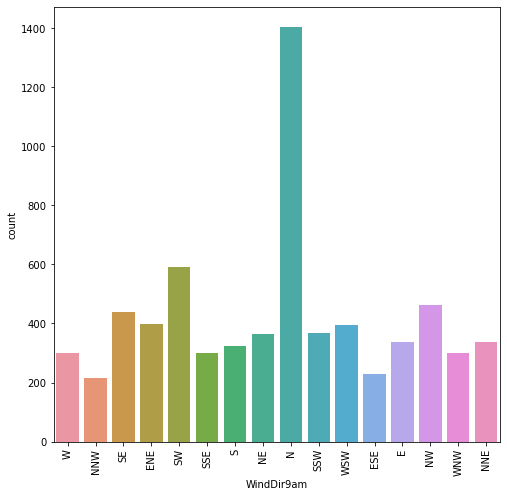

In [368]:
plt.figure(figsize=(8,8))
value=df['WindDir9am'].value_counts()
print('value count',value)
sns.countplot(df['WindDir9am'])
plt.xticks(rotation=90)
plt.show()

WindDir9am is maximum at direction 'N' & minimum at direction 'NNW'

value count SE     971
WSW    499
S      493
NE     480
SW     428
SSE    421
NW     400
W      399
E      392
WNW    389
ESE    363
N      354
ENE    348
NNE    305
SSW    277
NNW    243
Name: WindDir3pm, dtype: int64


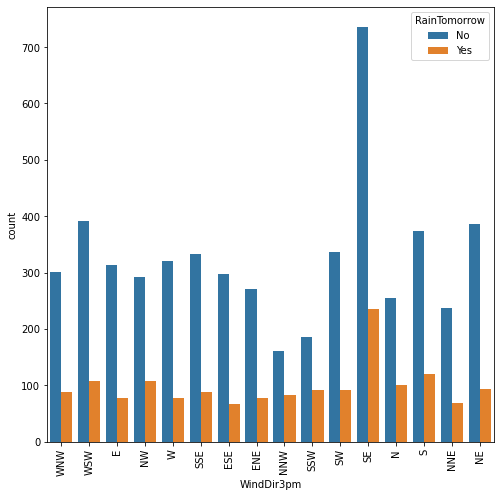

In [369]:
plt.figure(figsize=(8,8))
value=df['WindDir3pm'].value_counts()
print('value count',value)
sns.countplot(df['WindDir3pm'],hue=df['RainTomorrow'])
plt.xticks(rotation=90)
plt.show()

We can see that the maximum count of 'SE' direction and the probability to rain tomorrow is also from 'SE' Direction and the least of both is from NNW.

value count SE     971
WSW    499
S      493
NE     480
SW     428
SSE    421
NW     400
W      399
E      392
WNW    389
ESE    363
N      354
ENE    348
NNE    305
SSW    277
NNW    243
Name: WindDir3pm, dtype: int64


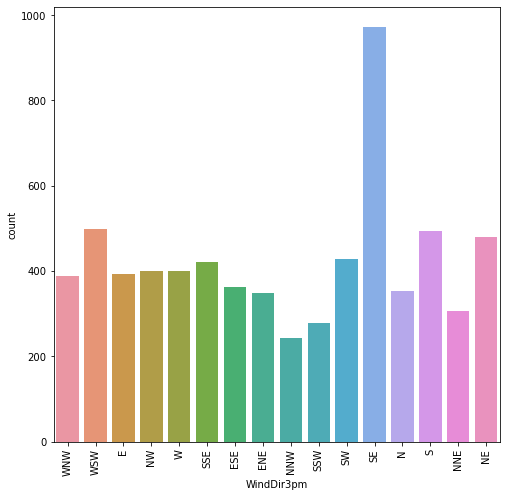

In [370]:
plt.figure(figsize=(8,8))
value=df['WindDir3pm'].value_counts()
print('value count',value)
sns.countplot(df['WindDir3pm'])
plt.xticks(rotation=90)
plt.show()

WindDir3pm is maximum at direction 'SE' & minimum at direction 'NNW'

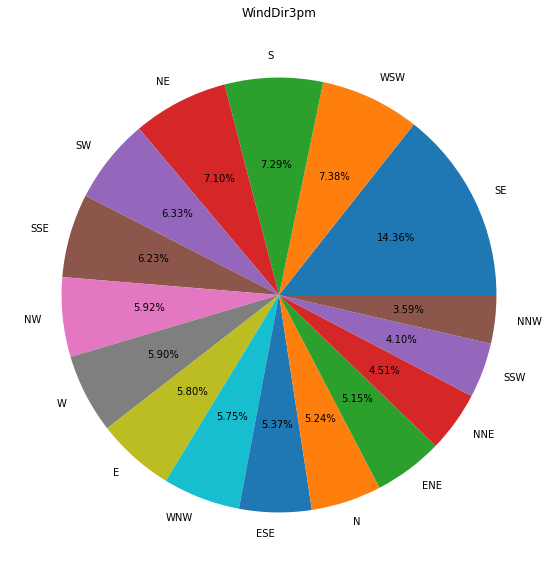

SE     971
WSW    499
S      493
NE     480
SW     428
SSE    421
NW     400
W      399
E      392
WNW    389
ESE    363
N      354
ENE    348
NNE    305
SSW    277
NNW    243
Name: WindDir3pm, dtype: int64

In [371]:
plt.figure(figsize=(15,10))
plt.pie(df['WindDir3pm'].value_counts().values,labels=df['WindDir3pm'].value_counts().index,autopct='%1.2f%%')
plt.title('WindDir3pm')
plt.show()



df['WindDir3pm'].value_counts()

Here we can see pie chart distribution for  WindDir3pm column

Value_Counts :- No     5190
Yes    1572
Name: RainToday, dtype: int64


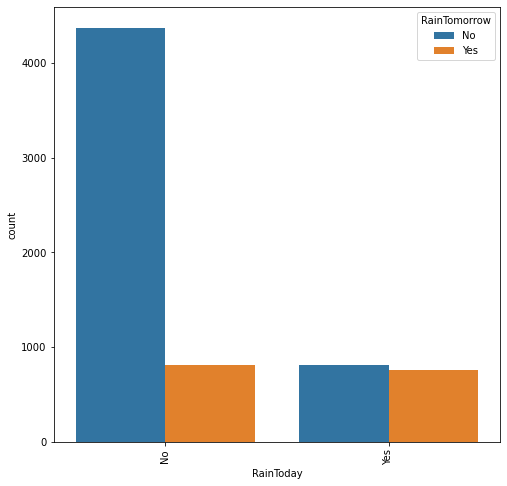

In [372]:
plt.figure(figsize=(8,8))
print ('Value_Counts :-',df['RainToday'].value_counts())
sns.countplot(df['RainToday'],hue=df['RainTomorrow'])
plt.xticks(rotation=90)
plt.show()

When there is a chance of rain today ,so there can be equal chance of rain tomorrow atleast 90%

Value_Counts :- No     5190
Yes    1572
Name: RainToday, dtype: int64


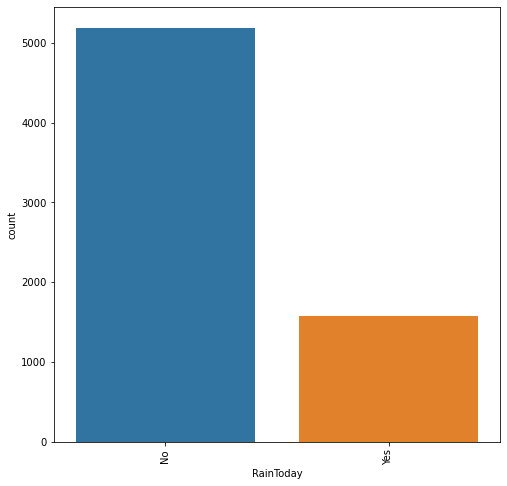

In [373]:
plt.figure(figsize=(8,8))
print ('Value_Counts :-',df['RainToday'].value_counts())
sns.countplot(df['RainToday'])
plt.xticks(rotation=90)
plt.show()

The max probability of rain is No as per the count

Value_Counts :- No     5190
Yes    1572
Name: RainTomorrow, dtype: int64


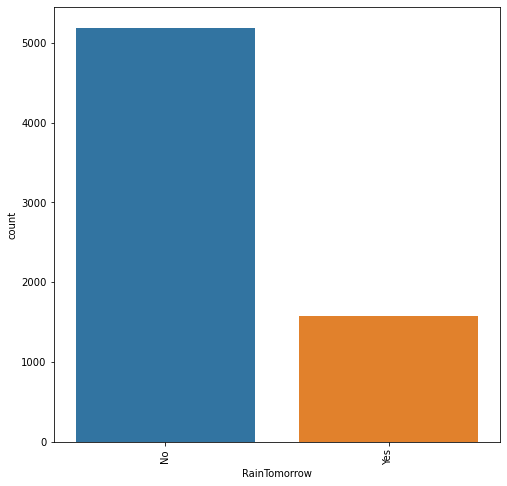

In [374]:
plt.figure(figsize=(8,8))
print ('Value_Counts :-',df['RainTomorrow'].value_counts())
sns.countplot(df['RainTomorrow'])
plt.xticks(rotation=90)
plt.show()

The probability for RainTomorrow is higher with no with 4946 value counts and lower with yes with 1359 value counts.

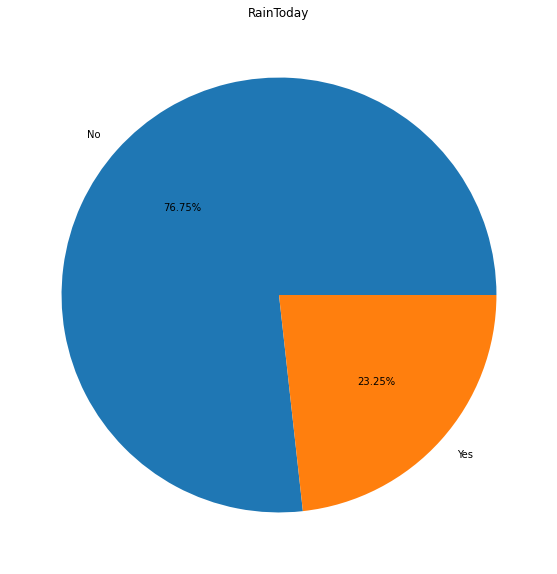

In [375]:
plt.figure(figsize=(15,10))
plt.pie(df['RainToday'].value_counts().values,labels=df['RainToday'].value_counts().index,autopct='%1.2f%%')
plt.title('RainToday')
plt.show()

There is a 23.25% chances for RainToday and 76.75% chances for no raintoday

### Bivarient Analysis

<AxesSubplot:xlabel='MaxTemp', ylabel='MinTemp'>

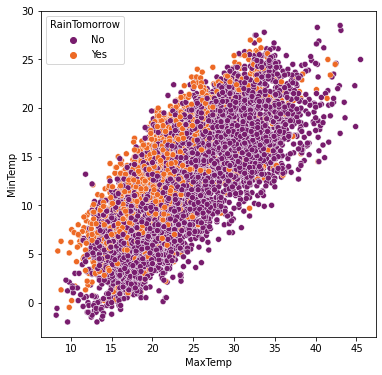

In [376]:
plt.figure(figsize=(6,6))
sns.scatterplot(x='MaxTemp' , y='MinTemp', hue='RainTomorrow', palette='inferno', data=df)

There is a linear positive correlation between maxtem and min temp with hue= RainTomorrow

<AxesSubplot:xlabel='Humidity9am', ylabel='Temp9am'>

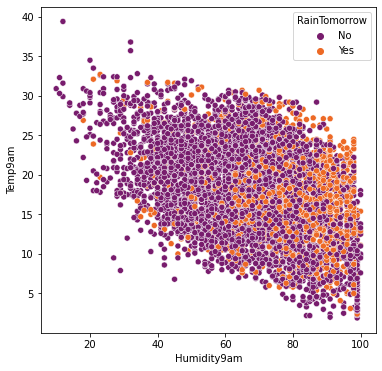

In [377]:
plt.figure(figsize=(6,6))
sns.scatterplot(x='Humidity9am' , y='Temp9am', hue='RainTomorrow', palette='inferno', data=df)

There is a negative linear correlation between humidity9am and temp9am with hue=RainTomorrow.

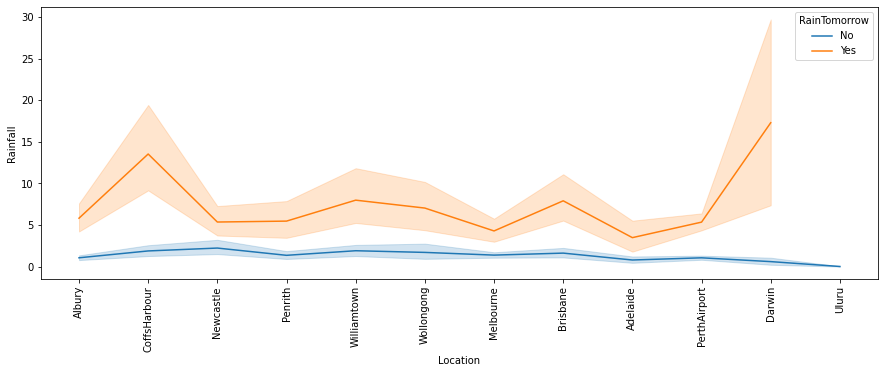

In [378]:
#Let us find the rainfall at different location
plt.figure(figsize=(15,5))
plt.xticks(rotation=90)
sns.lineplot(df['Location'],df['Rainfall'],hue=df['RainTomorrow'])
plt.show()

Darwin and CoffsHarbour seems to be having the maximum chances of rainfall tommorrow and Uluru seems to be least having the chance

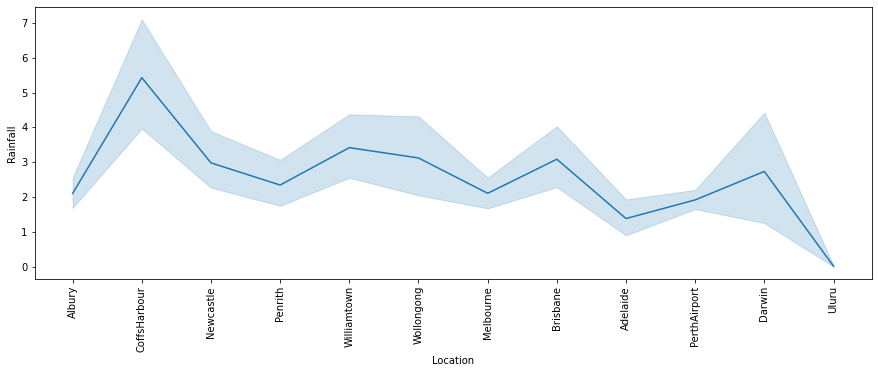

In [379]:
#Let us find the rainfall at different location
plt.figure(figsize=(15,5))
plt.xticks(rotation=90)
sns.lineplot(df['Location'],df['Rainfall'])
plt.show()

CoffsHarbour and Darwin seems to be have the maximum amount of rainfall

<Figure size 720x720 with 0 Axes>

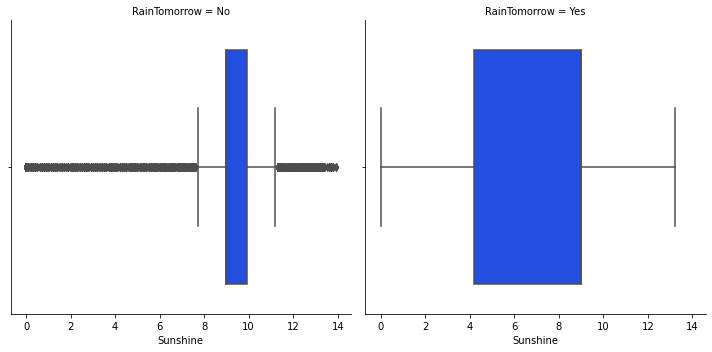

In [380]:
plt.figure(figsize = (10,10))
sns.catplot(x='Sunshine',col='RainTomorrow',data=df,kind='box',palette="bright")
plt.show()

If we have sunlight from 8hrs to 10+ hrs in a day tomorrow the probability of rainfall is less and if we have sunlight for 4 to 8.5 hrs chances of rain are possible tomorrow

<Figure size 720x720 with 0 Axes>

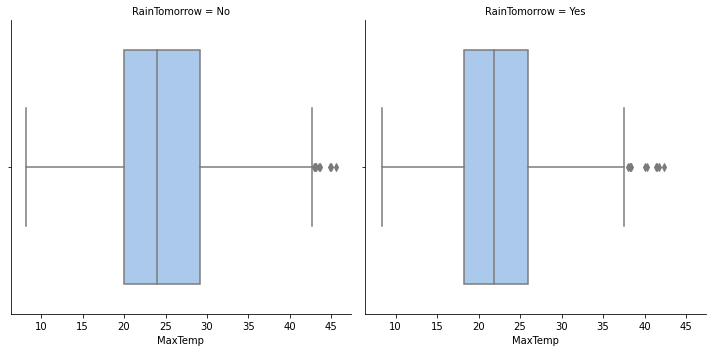

In [381]:
plt.figure(figsize = (10,10))
sns.catplot(x='MaxTemp',col='RainTomorrow',data=df,kind='box',palette="pastel")
plt.show()

If the max temp. is between 25 to 30 degree in a dat tomorrow than there is a less probability of rainfall and if the max temp. is between 18 to 27 degree than there is a high probability for rainfall tomorrow

<Figure size 720x720 with 0 Axes>

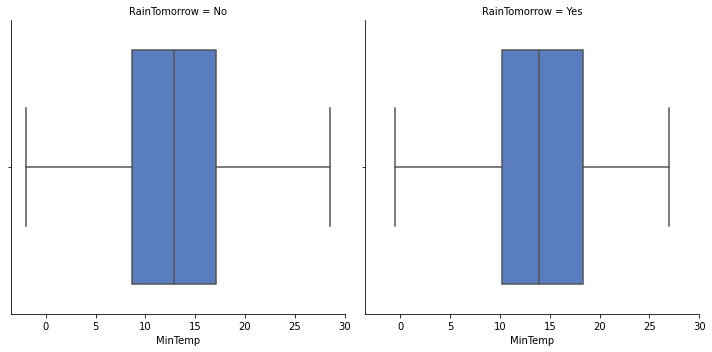

In [382]:
plt.figure(figsize = (10,10))
sns.catplot(x='MinTemp',col='RainTomorrow',data=df,kind='box',palette="muted")
plt.show()

If min. temp. is between 10 to 19 than there is a high probability of the tomorrow rainfall and if the min. temp. is between 9 to 16 than there will be less probability of tomorrow rainfall 

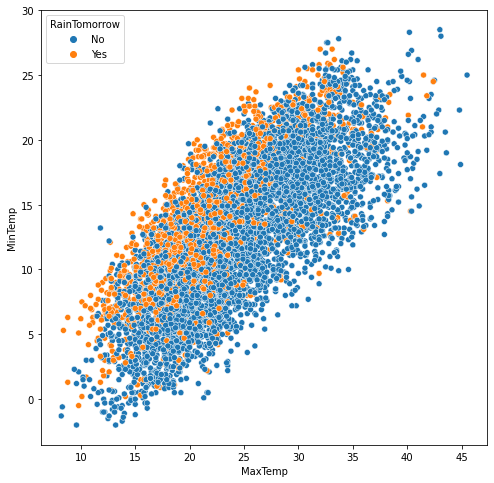

In [383]:
plt.figure(figsize=(8,8))
sns.scatterplot( x = "MaxTemp",y = "MinTemp", data = df,hue="RainTomorrow")
plt.show()

We can see that MinTemp and MaxTemp have Linear Relationship to rain tomorrow column,

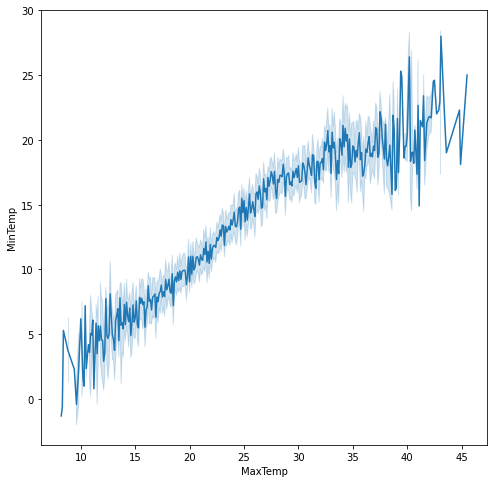

In [384]:
plt.figure(figsize=(8,8))
sns.lineplot( x = "MaxTemp",y = "MinTemp", data = df)
plt.show()

There is a postive linear relationship between maxtemp and mintemp 

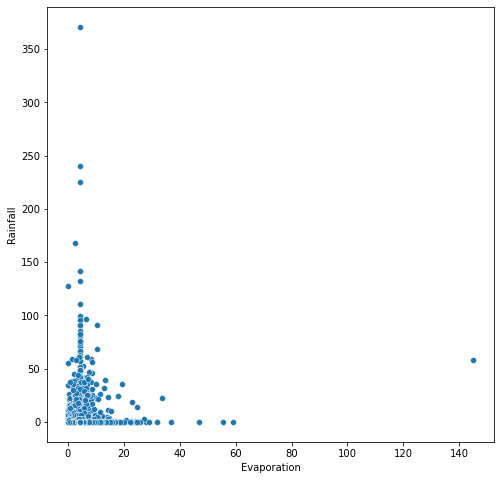

In [385]:
plt.figure(figsize=(8,8))
sns.scatterplot( x = "Evaporation",y = "Rainfall", data = df)
plt.show()

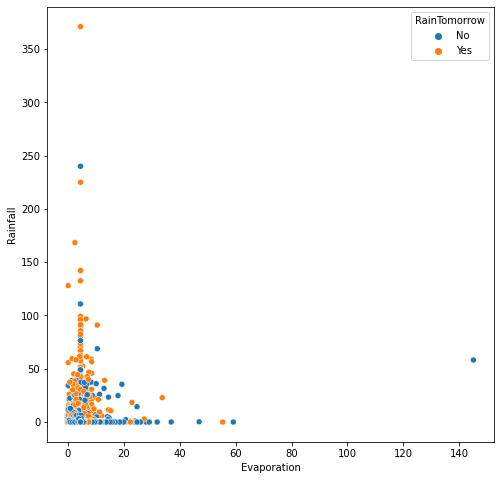

In [386]:
plt.figure(figsize=(8,8))
sns.scatterplot( x = "Evaporation",y = "Rainfall", data = df,hue="RainTomorrow")
plt.show()

Till evaportation 5mm we see the maximum rainfall and if we have 5mm evaporation tomorrow we can expect rainfall

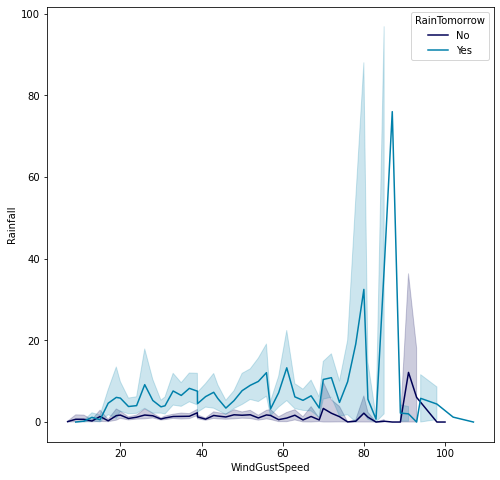

In [387]:
plt.figure(figsize=(8,8))
sns.lineplot( y = "Rainfall",x = "WindGustSpeed", data = df,hue="RainTomorrow",palette="ocean")
plt.show()

If we have a Wind Speed of 80 to 90 there are max chances of rainfall tommorrow

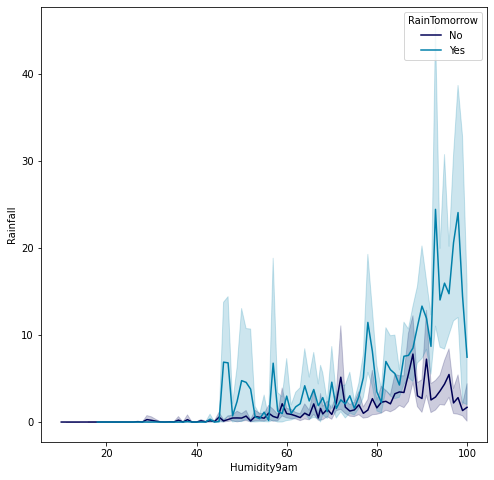

In [388]:
plt.figure(figsize=(8,8))
sns.lineplot( y = "Rainfall",x = "Humidity9am", data = df,hue="RainTomorrow",palette="ocean")
plt.show()

if we have a humidity of max 83 to 100 ,there are max possibility of rainfall tomorrow at 9am

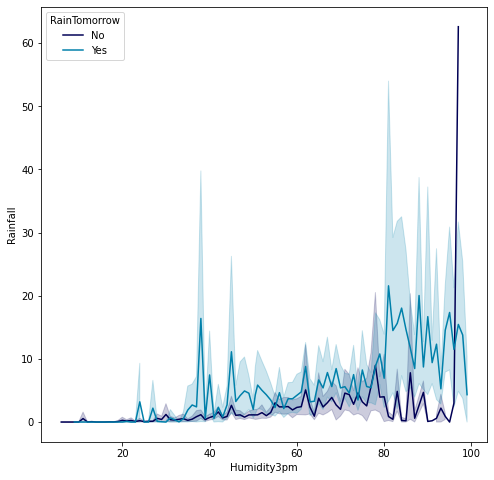

In [389]:
plt.figure(figsize=(8,8))
sns.lineplot( y = "Rainfall",x = "Humidity3pm", data = df,hue="RainTomorrow",palette="ocean")
plt.show()

 if we have a humidity of max 83 to 100 ,there are max possibility of rainfall tomorrow

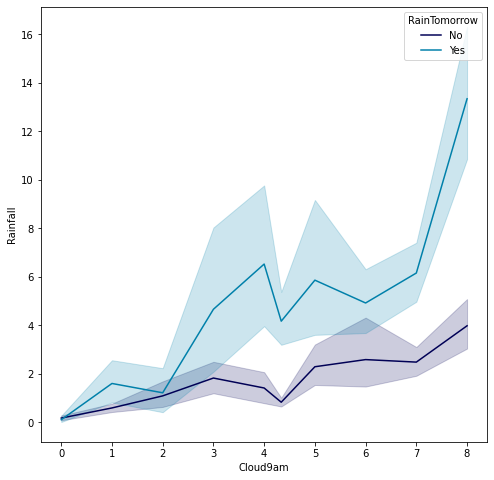

In [390]:
plt.figure(figsize=(8,8))
sns.lineplot( y = "Rainfall",x = "Cloud9am", data = df,hue="RainTomorrow",palette="ocean")
plt.show()

if we have 2-5 Fraction of sky obscured by cloud ,there are possibility of rainfall tomorrow at 9am

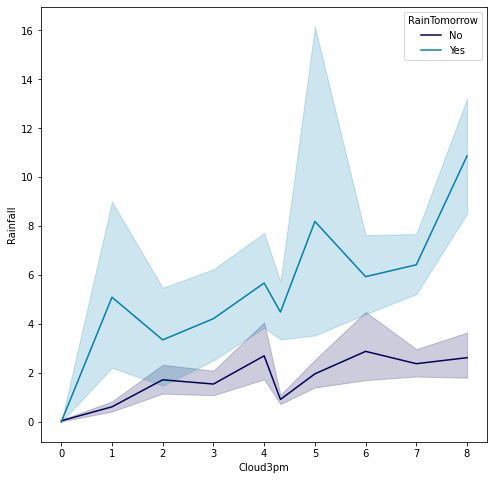

In [391]:
plt.figure(figsize=(8,8))
sns.lineplot( y = "Rainfall",x = "Cloud3pm", data = df,hue="RainTomorrow",palette="ocean")
plt.show()

if we have 4-6 Fraction of sky obscured by cloud ,there are possibility of rainfall tomorrow at 3pm

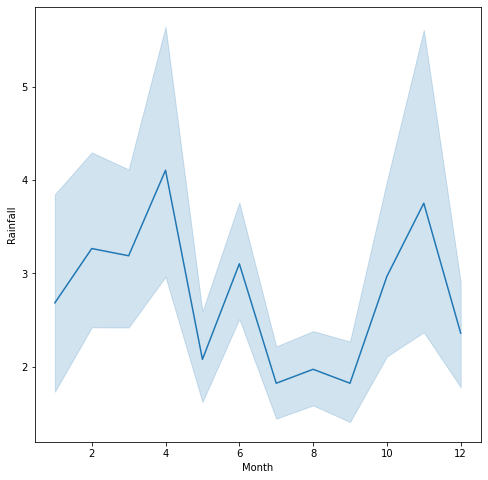

In [392]:
plt.figure(figsize=(8,8))
sns.lineplot( y = "Rainfall",x = "Month", data = df,palette="ocean")
plt.show()

Here have Observed that rainfall has been taken place in march, april ,october and November month

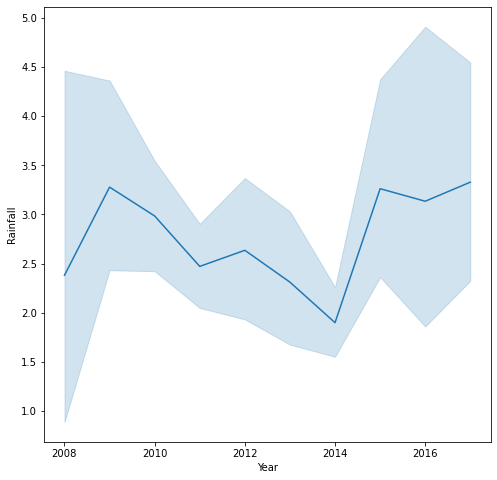

In [393]:
plt.figure(figsize=(8,8))
sns.lineplot( y = "Rainfall",x = "Year", data = df,palette="ocean")
plt.show()

Rainfall is maximum in 2015 and 2009 and minimum at 2014 year

<AxesSubplot:xlabel='Pressure3pm', ylabel='Pressure9am'>

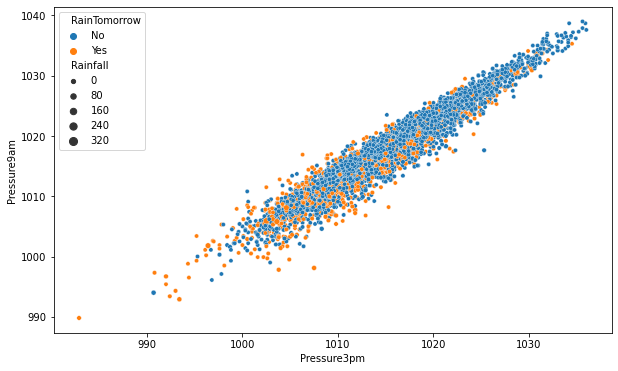

In [394]:
plt.figure(figsize=(10,6))
sns.scatterplot(df['Pressure3pm'],df['Pressure9am'],hue='RainTomorrow',size='Rainfall',data=df)

### Multivarient Analysis

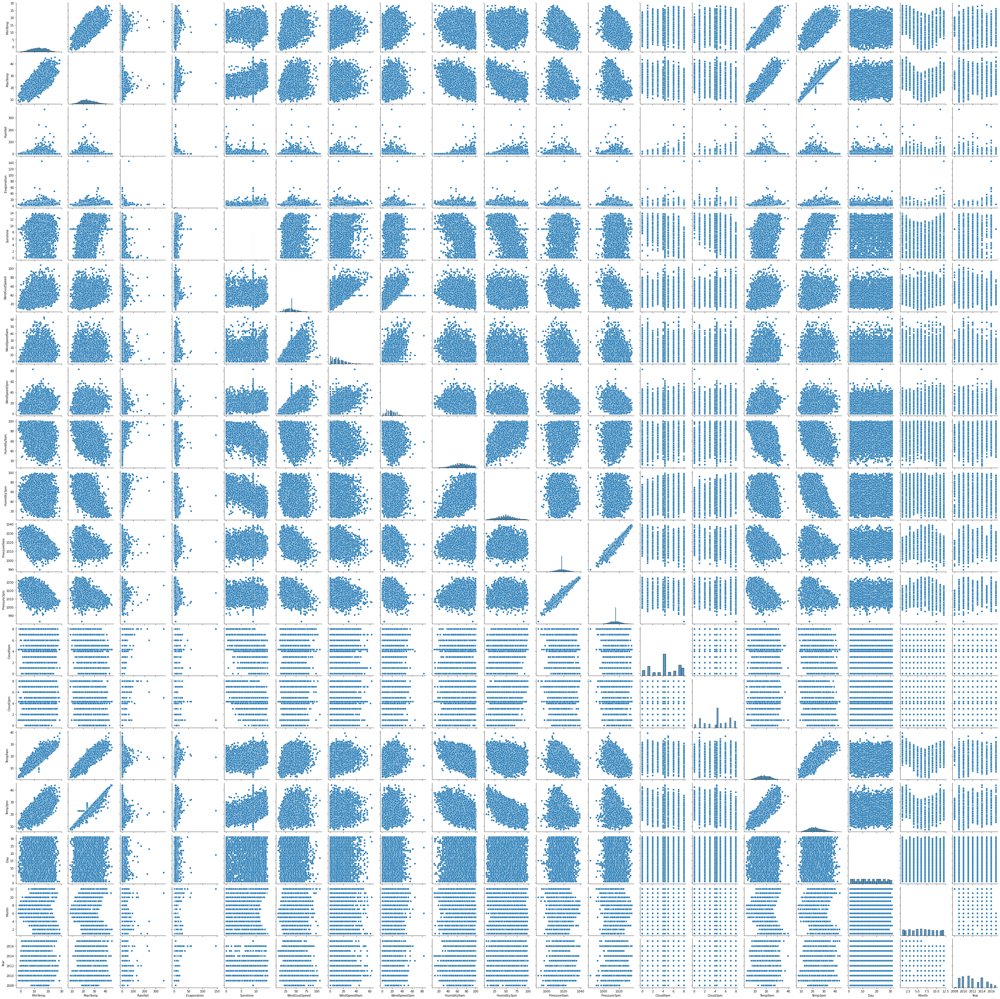

In [395]:
sns.pairplot(df)
plt.show()

Here we can see the pairplot of all the variable present in the dataset

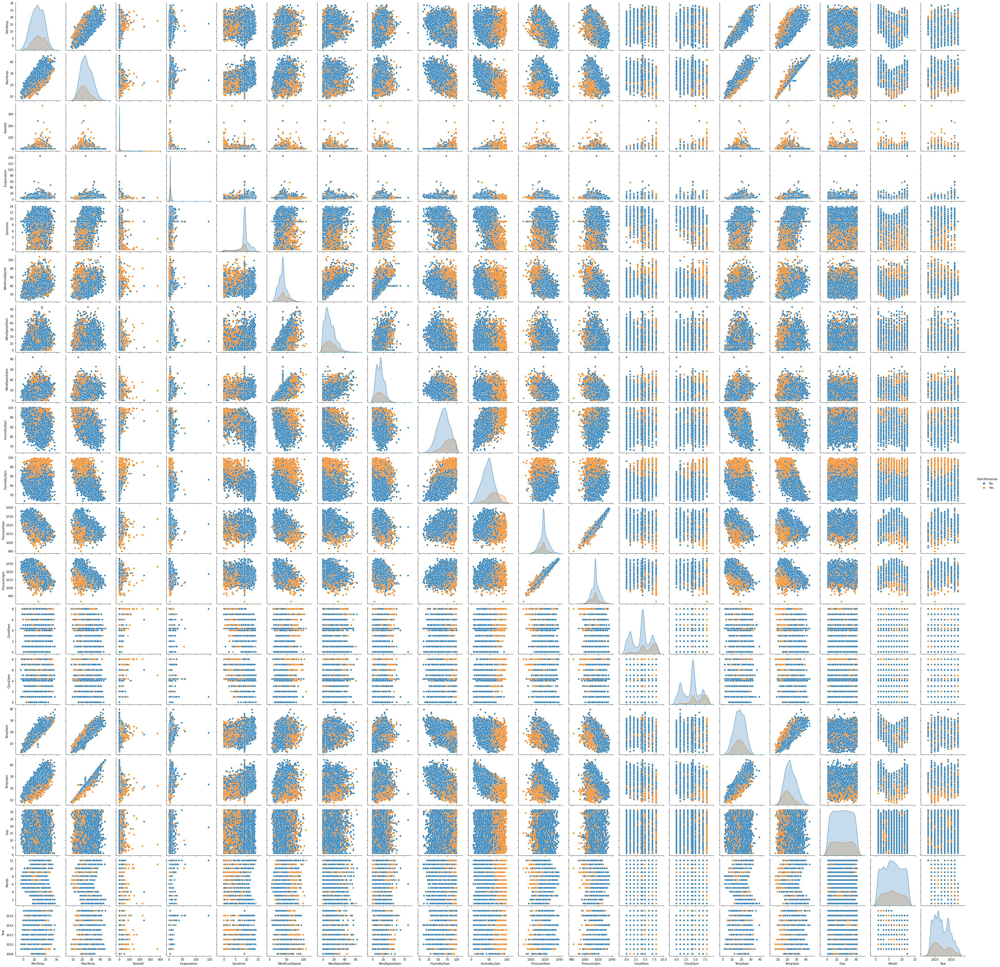

In [396]:
sns.pairplot(df, hue='RainTomorrow')
plt.show()

This pair plot gives the relation between the columns which is plotted on the basis of target variable "RainTomorrow". Here we can observe the relation between the features and label.

# Checking for outliers

We never check prescence of outliers from categorical columns and target variables & to check the prescence of outliers we use boxplot visualization.

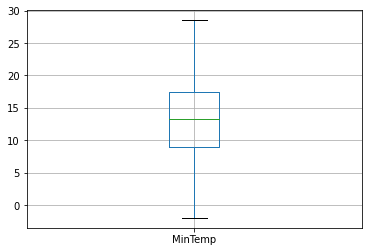

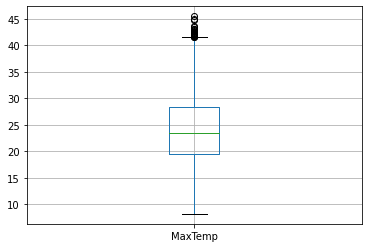

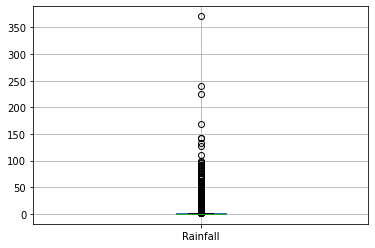

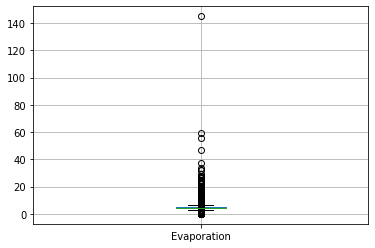

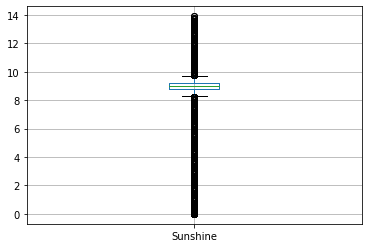

...

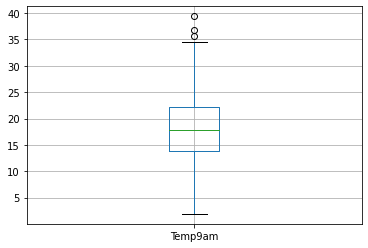

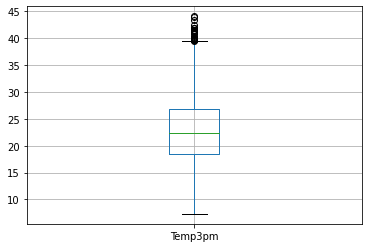

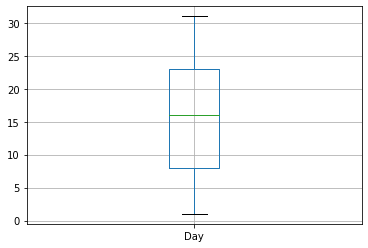

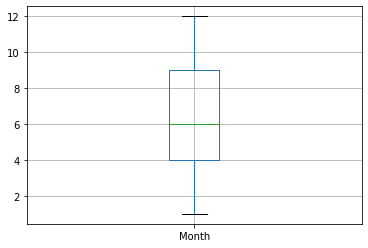

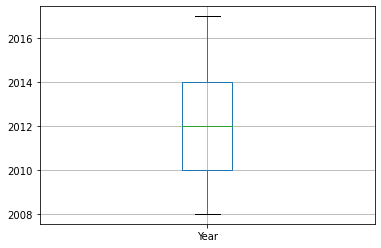

In [397]:
for i in numerical_columns:
    df.boxplot(i)
    plt.show()

By visualizing with boxplot we can say that outliers are present in the dataset & we have to remove the outlies from the dataset

# Removing outliers

In [398]:
#Removing outliers
from scipy.stats import zscore
z=np.abs(zscore(df[numerical_columns]))

z

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Day,Month,Year
0,0.052329,0.194668,0.202435,0.11869,0.207361,3.754887e-01,0.737499,0.673324,0.203327,1.539016,1.646846,1.344002,1.480398,0.000000,0.173897,0.152152,1.675969,1.639768,1.761148
1,1.030652,0.164227,0.259635,0.11869,0.207361,3.754887e-01,0.897347,0.463855,1.368138,1.376828,1.165715,1.226694,0.000000,0.000000,0.121468,0.266510,1.562245,1.639768,1.761148
2,0.037920,0.262108,0.259635,0.11869,0.207361,5.250161e-01,0.635321,0.882794,1.717352,1.106513,1.663437,1.075869,0.000000,0.999089,0.542637,0.082299,1.448521,1.639768,1.761148
3,0.705758,0.637317,0.259635,0.11869,0.207361,1.119786e+00,0.182102,0.897697,1.309935,1.863394,0.004365,0.388779,0.000000,0.000000,0.035820,0.634933,1.334798,1.639768,1.761148
4,0.792365,1.338795,0.164301,0.11869,0.207361,1.511975e-01,0.590814,0.254385,0.843553,0.944325,1.132534,1.528343,1.076270,1.583662,0.016609,1.170820,1.221074,1.639768,1.761148
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,1.860937,0.113101,0.259635,0.11869,0.207361,5.964399e-01,0.022254,0.688228,0.960721,1.430891,1.156985,0.868092,0.000000,0.000000,1.362295,0.051673,0.598504,0.136841,2.150387
8421,1.716540,0.196854,0.259635,0.11869,0.207361,1.269314e+00,0.022254,0.897697,0.669709,1.593079,0.974487,0.666993,0.000000,0.000000,1.222484,0.300003,0.712227,0.136841,2.150387
8422,1.391646,0.457869,0.259635,0.11869,0.207361,1.478575e-01,0.386458,0.897697,0.844316,1.430891,0.559719,0.281552,0.000000,0.000000,0.942861,0.567947,0.825951,0.136841,2.150387
8423,0.958453,0.474183,0.259635,0.11869,0.207361,8.207311e-01,0.022254,1.107167,0.960721,1.430891,0.294268,0.231277,0.540240,0.999089,0.488473,0.551200,0.939675,0.136841,2.150387


In [399]:
#threshold value =3
threshold=3

print(np.where(z>3))

(array([   8,   12,   12,   44,   44,   52,   52,   60,   60,   61,   61,
         62,   62,   62,   67,   68,   68,  123,  267,  271,  296,  381,
        381,  405,  406,  407,  431,  462,  466,  466,  563,  567,  568,
        568,  569,  602,  602,  603,  683,  683,  699,  713,  748,  748,
        770,  795,  796,  797,  802,  928,  928,  928,  935,  941,  949,
        978,  979,  979,  980,  980,  980,  980,  981, 1007, 1008, 1008,
       1009, 1010, 1011, 1115, 1138, 1138, 1148, 1148, 1149, 1150, 1151,
       1189, 1202, 1202, 1203, 1237, 1241, 1264, 1264, 1265, 1265, 1356,
       1357, 1386, 1411, 1412, 1413, 1465, 1466, 1479, 1479, 1480, 1480,
       1481, 1486, 1513, 1513, 1535, 1587, 1644, 1661, 1665, 1673, 1680,
       1774, 1819, 1873, 1898, 1903, 1945, 2016, 2028, 2043, 2074, 2108,
       2116, 2186, 2201, 2219, 2219, 2230, 2231, 2265, 2429, 2488, 2500,
       2505, 2527, 2527, 2541, 2593, 2676, 2677, 2735, 2827, 2835, 2837,
       2849, 2849, 2855, 2859, 2863, 2869, 2877, 2

In [400]:
df_new=df[(z<3).all(axis=1)]

df_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,Albury,13.4,22.9,0.6,4.6,9.0,W,44.000000,W,WNW,...,1007.1,8.000000,4.320988,16.9,21.8,No,No,1,12,2008
1,Albury,7.4,25.1,0.0,4.6,9.0,WNW,44.000000,NNW,WSW,...,1007.8,4.336806,4.320988,17.2,24.3,No,No,2,12,2008
2,Albury,12.9,25.7,0.0,4.6,9.0,WSW,46.000000,W,WSW,...,1008.7,4.336806,2.000000,21.0,23.2,No,No,3,12,2008
3,Albury,9.2,28.0,0.0,4.6,9.0,NE,24.000000,SE,E,...,1012.8,4.336806,4.320988,18.1,26.5,No,No,4,12,2008
4,Albury,17.5,32.3,1.0,4.6,9.0,W,41.000000,ENE,NW,...,1006.0,7.000000,8.000000,17.8,29.7,No,No,5,12,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.4,0.0,4.6,9.0,E,31.000000,SE,ENE,...,1020.3,4.336806,4.320988,10.1,22.4,No,No,21,6,2017
8421,Uluru,3.6,25.3,0.0,4.6,9.0,NNW,22.000000,SE,N,...,1019.1,4.336806,4.320988,10.9,24.5,No,No,22,6,2017
8422,Uluru,5.4,26.9,0.0,4.6,9.0,N,37.000000,SE,WNW,...,1016.8,4.336806,4.320988,12.5,26.1,No,No,23,6,2017
8423,Uluru,7.8,27.0,0.0,4.6,9.0,SE,28.000000,SSE,N,...,1016.5,3.000000,2.000000,15.1,26.0,No,No,24,6,2017


In [401]:
df_new.shape

(6305, 25)

In [402]:
df.shape

(6762, 25)

In [403]:
#Checking dataloss
Dataloss = (((6762-6305)/6762)*100)
Dataloss

6.758355516119491

The dataloss is 6.75 % which is less than 10% so we can further proceed with the data.

In [404]:
df=df_new

In [405]:
df.shape

(6305, 25)

# Check for skewness

In [406]:
df.skew()

MinTemp         -0.073640
MaxTemp          0.263690
Rainfall         3.572436
Evaporation      1.136753
Sunshine        -1.358828
WindGustSpeed    0.475266
WindSpeed9am     0.674698
WindSpeed3pm     0.339786
Humidity9am     -0.224089
Humidity3pm      0.138110
Pressure9am      0.064634
Pressure3pm      0.086202
Cloud9am        -0.190400
Cloud3pm        -0.138218
Temp9am         -0.074991
Temp3pm          0.283877
Day              0.005324
Month            0.030646
Year             0.338266
dtype: float64

Accpetable range for skewness is -0.5 to +0.5 and according to this we can say that skewness is present in the column Evaportation, Sunshine [Rainfall] column also has skewness but we never treat skewness from target column. Here Rainfall & RainTomorrow. both are taregt variables so we didn't treat skewness from these columns & also skewness is never treated from categorical column.

# Treating skewness

In [407]:
df['Evaporation']=np.cbrt(df['Evaporation'])

In [408]:
df.skew()

MinTemp         -0.073640
MaxTemp          0.263690
Rainfall         3.572436
Evaporation     -0.574230
Sunshine        -1.358828
WindGustSpeed    0.475266
WindSpeed9am     0.674698
WindSpeed3pm     0.339786
Humidity9am     -0.224089
Humidity3pm      0.138110
Pressure9am      0.064634
Pressure3pm      0.086202
Cloud9am        -0.190400
Cloud3pm        -0.138218
Temp9am         -0.074991
Temp3pm          0.283877
Day              0.005324
Month            0.030646
Year             0.338266
dtype: float64

Here we can see that skewness is within the accpetable range in all the columns and we can't further treat more. and we can also check for skewness by visualizing with histrogram plots.

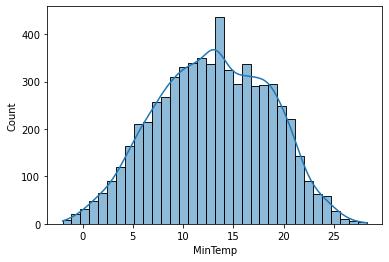

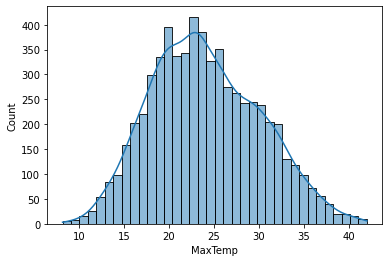

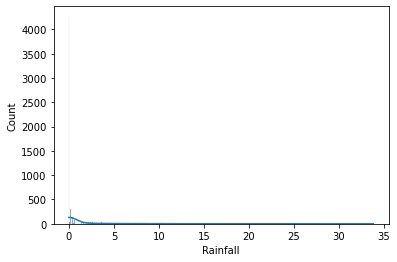

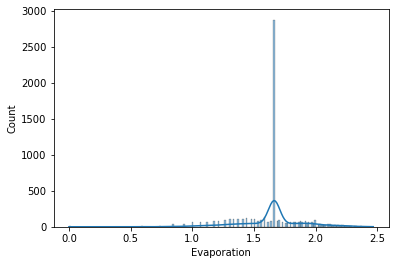

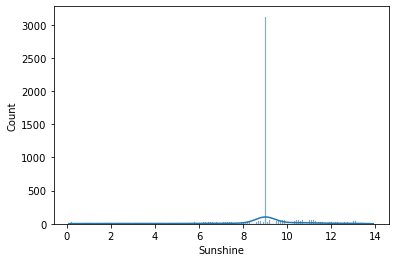

...

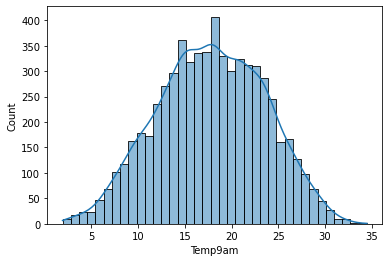

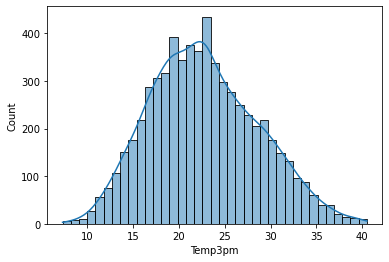

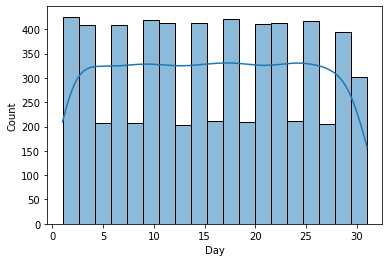

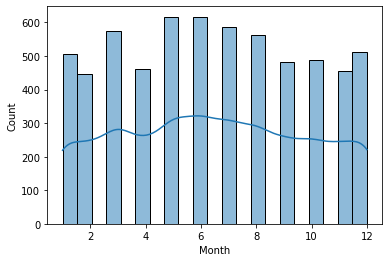

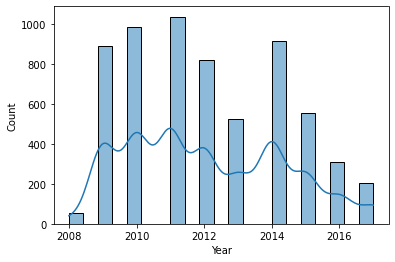

In [409]:
for i in numerical_columns:
    sns.histplot(df[i], kde=True)
    plt.show()

By visualizing with histplot we can see that skewness is not present in the dataset.

# Encoding the categorical columns using Label Encoding

In [410]:
from sklearn.preprocessing import LabelEncoder
lb=LabelEncoder()
for i in df.columns:
    if df[i].dtypes=='object':
        df[i]=lb.fit_transform(df[i].values)

In [411]:
df.sample(10)

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
2236,6,10.0,22.4,0.0,1.663103,9.0,0,38.977663,3,7,...,1015.119923,1.000000,6.000000,14.8,21.5,0,0,28,5,2015
1498,3,14.3,23.4,0.0,1.686865,8.7,4,48.000000,3,4,...,1019.100000,2.000000,1.000000,21.2,22.1,0,0,22,10,2010
8414,9,2.6,22.5,0.0,1.663103,9.0,8,19.000000,8,0,...,1021.400000,4.336806,4.320988,8.8,22.1,0,0,15,6,2017
2667,7,12.1,24.2,0.0,1.663103,9.0,8,30.000000,8,2,...,1015.119923,4.336806,4.320988,17.9,22.2,0,1,12,4,2015
4578,5,11.5,29.9,0.0,1.894536,12.7,3,41.000000,5,3,...,1017.600000,1.000000,1.000000,16.8,27.6,0,0,2,12,2009
7981,8,15.6,30.1,0.0,2.000000,13.2,11,46.000000,11,12,...,1014.200000,0.000000,0.000000,23.7,28.2,0,0,9,1,2014
3230,10,13.6,32.0,0.0,1.663103,9.0,4,39.000000,11,1,...,1005.700000,8.000000,8.000000,18.2,29.2,0,0,1,12,2016
5045,5,15.0,23.7,6.2,1.775808,10.7,8,39.000000,9,8,...,1023.100000,4.336806,4.320988,16.8,22.2,1,0,14,3,2011
6792,0,5.1,12.7,0.4,1.587401,9.0,13,24.000000,2,12,...,1032.100000,4.336806,4.320988,10.1,10.4,0,0,11,8,2014
2044,6,13.4,25.4,1.0,1.663103,9.0,0,38.977663,3,9,...,1015.119923,0.000000,1.000000,21.4,24.5,0,0,17,11,2014


# Correlation between target variable and independent variables

In [412]:
cor=df.corr()
cor

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
Location,1.000000,0.095996,0.072443,0.017224,0.100391,0.053118,-0.086156,0.272503,-0.100510,0.002253,...,-0.016923,0.000006,0.001074,0.100740,0.068662,0.002484,0.007519,-0.003702,-0.072855,0.504933
MinTemp,0.095996,1.000000,0.737725,0.086260,0.377527,0.032458,-0.143145,0.250152,-0.020086,-0.142837,...,-0.447000,0.087898,0.035641,0.894297,0.706923,0.062919,0.081773,0.017074,-0.234035,0.035303
MaxTemp,0.072443,0.737725,1.000000,-0.141079,0.472460,0.318902,-0.200268,0.171570,-0.192361,-0.166038,...,-0.426335,-0.232520,-0.231048,0.867117,0.974714,-0.219639,-0.154579,0.018575,-0.172085,0.077777
Rainfall,0.017224,0.086260,-0.141079,1.000000,-0.107047,-0.156651,0.073570,0.099116,0.121385,0.079713,...,-0.050933,0.228667,0.184469,-0.038111,-0.150573,0.703806,0.261425,-0.010499,-0.000151,0.004645
Evaporation,0.100391,0.377527,0.472460,-0.107047,1.000000,0.417080,-0.121215,0.200461,-0.107880,-0.026905,...,-0.300734,-0.113637,-0.158073,0.442157,0.460739,-0.186461,-0.101660,0.007439,-0.043026,0.092535
Sunshine,0.053118,0.032458,0.318902,-0.156651,0.417080,1.000000,-0.113866,0.006873,-0.096147,-0.051841,...,-0.083343,-0.476125,-0.506427,0.203692,0.340598,-0.210191,-0.299928,-0.002409,-0.004193,0.110968
WindGustDir,-0.086156,-0.143145,-0.200268,0.073570,-0.121215,-0.113866,1.000000,-0.000646,0.379358,0.454594,...,-0.010787,0.112706,0.072212,-0.157290,-0.212343,0.113372,0.035527,0.017805,0.032727,-0.184194
WindGustSpeed,0.272503,0.250152,0.171570,0.099116,0.200461,0.006873,-0.000646,1.000000,-0.065610,0.096825,...,-0.329080,0.003227,0.042059,0.227777,0.139624,0.082985,0.171287,-0.003166,0.048651,-0.015798
WindDir9am,-0.100510,-0.020086,-0.192361,0.121385,-0.107880,-0.096147,0.379358,-0.065610,1.000000,0.202162,...,0.051324,0.069157,0.052673,-0.065530,-0.202016,0.151341,0.034833,-0.004047,0.019081,-0.081273
WindDir3pm,0.002253,-0.142837,-0.166038,0.079713,-0.026905,-0.051841,0.454594,0.096825,0.202162,1.000000,...,-0.045147,0.074270,0.053453,-0.149872,-0.177421,0.101941,0.002626,0.002267,0.029038,0.007258


(array([ 0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5,  9.5, 10.5,
        11.5, 12.5, 13.5, 14.5, 15.5, 16.5, 17.5, 18.5, 19.5, 20.5, 21.5,
        22.5, 23.5, 24.5]),
 [Text(0, 0.5, 'Location'),
  Text(0, 1.5, 'MinTemp'),
  Text(0, 2.5, 'MaxTemp'),
  Text(0, 3.5, 'Rainfall'),
  Text(0, 4.5, 'Evaporation'),
  Text(0, 5.5, 'Sunshine'),
  Text(0, 6.5, 'WindGustDir'),
  Text(0, 7.5, 'WindGustSpeed'),
  Text(0, 8.5, 'WindDir9am'),
  Text(0, 9.5, 'WindDir3pm'),
  Text(0, 10.5, 'WindSpeed9am'),
  Text(0, 11.5, 'WindSpeed3pm'),
  Text(0, 12.5, 'Humidity9am'),
  Text(0, 13.5, 'Humidity3pm'),
  Text(0, 14.5, 'Pressure9am'),
  Text(0, 15.5, 'Pressure3pm'),
  Text(0, 16.5, 'Cloud9am'),
  Text(0, 17.5, 'Cloud3pm'),
  Text(0, 18.5, 'Temp9am'),
  Text(0, 19.5, 'Temp3pm'),
  Text(0, 20.5, 'RainToday'),
  Text(0, 21.5, 'RainTomorrow'),
  Text(0, 22.5, 'Day'),
  Text(0, 23.5, 'Month'),
  Text(0, 24.5, 'Year')])

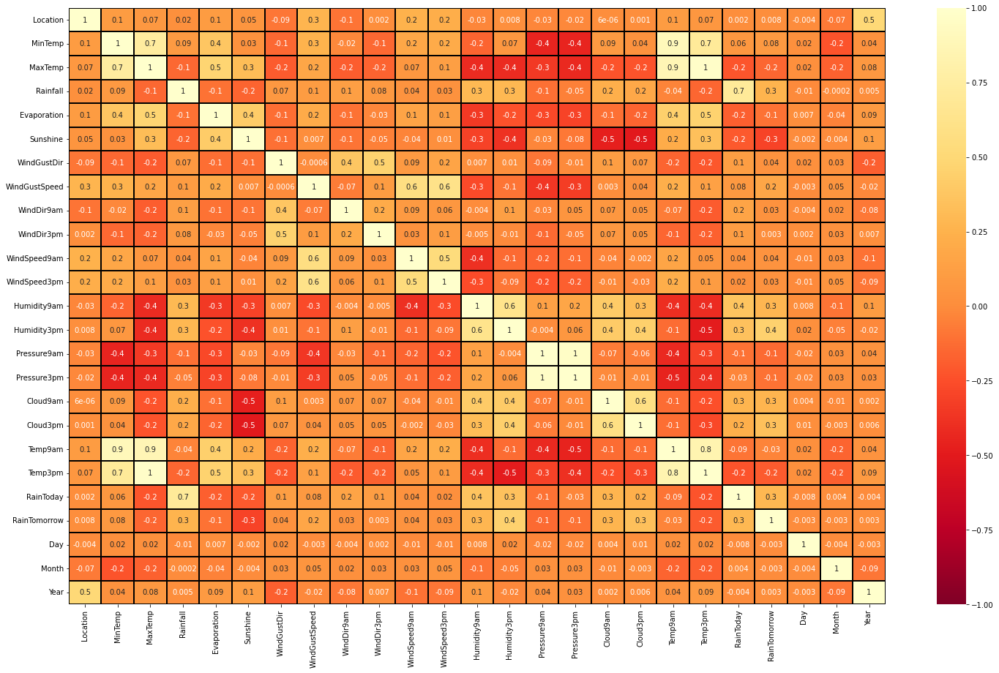

In [413]:
# Visualizing the correlation matrix by plotting heat map.
plt.figure(figsize=(25,15))
sns.heatmap(df_new.corr(),linewidths=.1,vmin=-1, vmax=1, fmt='.1g', annot = True, linecolor="black",annot_kws={'size':10},cmap="YlOrRd_r")
plt.yticks(rotation=0)

This heatmap shows the correlation matrix by visualizing the data. we can observe the relation between feature to feature and feature to label. This heat mapcontains both positive and negative correlation.

In [414]:
cor['RainTomorrow'].sort_values(ascending=False)

RainTomorrow     1.000000
Humidity3pm      0.448514
Cloud3pm         0.336968
RainToday        0.287793
Humidity9am      0.273882
Cloud9am         0.272583
Rainfall         0.261425
WindGustSpeed    0.171287
MinTemp          0.081773
WindSpeed9am     0.044587
WindGustDir      0.035527
WindDir9am       0.034833
WindSpeed3pm     0.032622
Location         0.007519
Year             0.002994
WindDir3pm       0.002626
Day             -0.002709
Month           -0.003276
Temp9am         -0.031287
Evaporation     -0.101660
Pressure3pm     -0.109354
Pressure9am     -0.135667
MaxTemp         -0.154579
Temp3pm         -0.197912
Sunshine        -0.299928
Name: RainTomorrow, dtype: float64

RainTomorrow is highly correlated with humidity3pm and colud3pm & less correlated with Temp3pm and sunshine.

# Visualizing the correlation between label and features

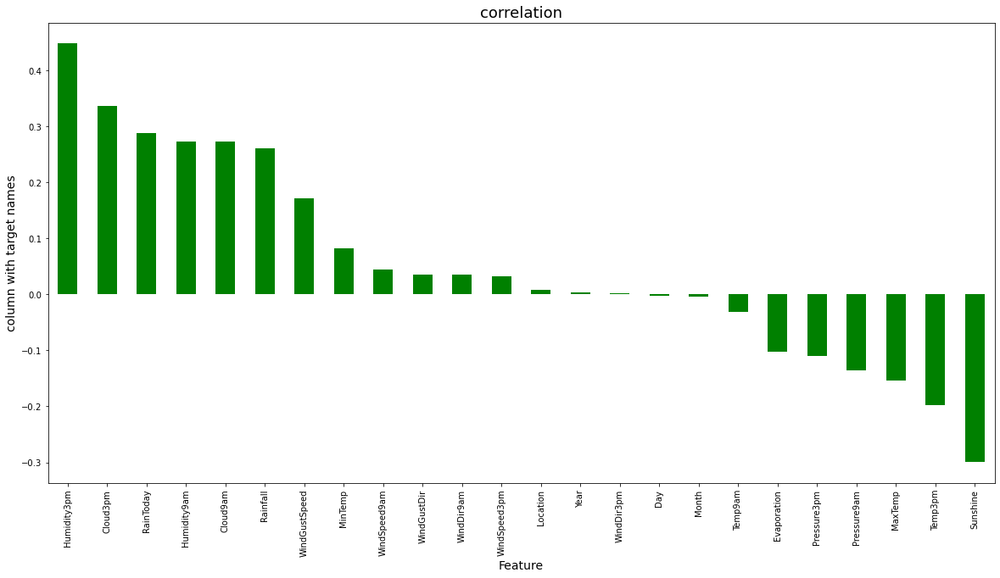

In [415]:
plt.figure(figsize=(20,10))
df_new.corr()['RainTomorrow'].sort_values(ascending=False).drop(['RainTomorrow']).plot(kind='bar',color='g')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('column with target names',fontsize=14)
plt.title('correlation',fontsize=18)
plt.show()

WindDir3pm, year, day  is very less correlated with target column

# Seprating features and label

In [416]:
x = df.drop("RainTomorrow", axis=1)
y = df["RainTomorrow"]

In [417]:
x

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Day,Month,Year
0,1,13.4,22.9,0.6,1.663103,9.0,13,44.000000,13,14,...,1007.7,1007.1,8.000000,4.320988,16.9,21.8,0,1,12,2008
1,1,7.4,25.1,0.0,1.663103,9.0,14,44.000000,6,15,...,1010.6,1007.8,4.336806,4.320988,17.2,24.3,0,2,12,2008
2,1,12.9,25.7,0.0,1.663103,9.0,15,46.000000,13,15,...,1007.6,1008.7,4.336806,2.000000,21.0,23.2,0,3,12,2008
3,1,9.2,28.0,0.0,1.663103,9.0,4,24.000000,9,0,...,1017.6,1012.8,4.336806,4.320988,18.1,26.5,0,4,12,2008
4,1,17.5,32.3,1.0,1.663103,9.0,13,41.000000,1,7,...,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0,5,12,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.4,0.0,1.663103,9.0,0,31.000000,9,1,...,1024.6,1020.3,4.336806,4.320988,10.1,22.4,0,21,6,2017
8421,9,3.6,25.3,0.0,1.663103,9.0,6,22.000000,9,3,...,1023.5,1019.1,4.336806,4.320988,10.9,24.5,0,22,6,2017
8422,9,5.4,26.9,0.0,1.663103,9.0,3,37.000000,9,14,...,1021.0,1016.8,4.336806,4.320988,12.5,26.1,0,23,6,2017
8423,9,7.8,27.0,0.0,1.663103,9.0,9,28.000000,10,3,...,1019.4,1016.5,3.000000,2.000000,15.1,26.0,0,24,6,2017


In [418]:
y

0       0
1       0
2       0
3       0
4       0
       ..
8420    0
8421    0
8422    0
8423    0
8424    0
Name: RainTomorrow, Length: 6305, dtype: int32

In [419]:
x.shape

(6305, 24)

In [420]:
y.shape

(6305,)

# Feature Scaling using Standard Scalarization

In [421]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Day,Month,Year
0,-1.390820,0.076961,-0.200778,-0.253612,0.054779,0.154322,1.224412,0.482848,1.321318,1.371163,...,-1.768165,-1.441508,1.523901,0.038815,-0.163129,-0.160972,-0.526886,-1.671897,1.653994,-1.771042
1,-1.390820,-1.005480,0.164759,-0.383028,0.054779,0.154322,1.415150,0.482848,-0.221198,1.594258,...,-1.259404,-1.317652,0.034278,0.038815,-0.110493,0.265627,-0.526886,-1.558125,1.653994,-1.771042
2,-1.390820,-0.013242,0.264451,-0.383028,0.054779,0.154322,1.605888,0.646734,1.321318,1.594258,...,-1.785708,-1.158408,0.034278,-0.969817,0.556227,0.077923,-0.526886,-1.444353,1.653994,-1.771042
3,-1.390820,-0.680748,0.646603,-0.383028,0.054779,0.154322,-0.492227,-1.156011,0.439880,-1.752177,...,-0.031361,-0.432963,0.034278,0.038815,0.047414,0.641034,-0.526886,-1.330582,1.653994,-1.771042
4,-1.390820,0.816629,1.361061,-0.167335,0.054779,0.154322,1.224412,0.237020,-1.322996,-0.190507,...,-1.224317,-1.636140,1.117255,1.637603,-0.005222,1.187080,-0.526886,-1.216810,1.653994,-1.771042
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6300,1.194987,-1.835352,-0.117701,-0.383028,0.054779,0.154322,-1.255179,-0.582410,0.439880,-1.529081,...,1.196682,0.894069,0.034278,0.038815,-1.356207,-0.058588,-0.526886,0.603542,-0.135987,2.153732
6301,1.194987,-1.691026,0.197990,-0.383028,0.054779,0.154322,-0.110752,-1.319897,0.439880,-1.082890,...,1.003704,0.681744,0.034278,0.038815,-1.215845,0.299755,-0.526886,0.717314,-0.135987,2.153732
6302,1.194987,-1.366294,0.463834,-0.383028,0.054779,0.154322,-0.682965,-0.090752,0.439880,1.371163,...,0.565117,0.274787,0.034278,0.038815,-0.935120,0.572778,-0.526886,0.831086,-0.135987,2.153732
6303,1.194987,-0.933317,0.480450,-0.383028,0.054779,0.154322,0.461461,-0.828239,0.660240,-1.082890,...,0.284421,0.221706,-0.509329,-0.969817,-0.478944,0.555714,-0.526886,0.944858,-0.135987,2.153732


We have scaled the data using standard scalarization method to overcome the issue of biasness we have use standard scaler which will convert dataset into mean=0 and std=1

Now we check for the multicolinearity for this we use Variance Inflation factor(VIF) method

# Checking for multicolinearity

In [422]:
# Find Varience Inflation Factor (VIF) in each scaled column above.

from statsmodels.stats.outliers_influence import variance_inflation_factor
import pandas as pd


vif = pd.DataFrame()

vif['VIF values'] = [variance_inflation_factor(x.values, i)
              for i in range(len(x.columns))]
vif['RainTomorrow'] = x.columns

vif

,VIF values,RainTomorrow
0,1.639313,Location
1,9.199852,MinTemp
2,26.166826,MaxTemp
3,2.020437,Rainfall
4,1.641749,Evaporation
5,1.830394,Sunshine
6,1.578566,WindGustDir
7,2.241688,WindGustSpeed
8,1.332090,WindDir9am
9,1.421878,WindDir3pm


if vif value is greater than 10 than we can say that multicolinearity is present in the dataset, and here Temp3pm,Temp9am,Pressure3pm,Pressure9am,MaxTemp.

In [423]:
x.drop('Temp3pm',axis=1,inplace=True)

In [424]:
# Find Varience Inflation Factor (VIF) in each scaled column above.

from statsmodels.stats.outliers_influence import variance_inflation_factor
import pandas as pd


vif = pd.DataFrame()

vif['VIF values'] = [variance_inflation_factor(x.values, i)
              for i in range(len(x.columns))]
vif['RainTomorrow'] = x.columns

vif

,VIF values,RainTomorrow
0,1.639276,Location
1,9.156490,MinTemp
2,9.583699,MaxTemp
3,2.019789,Rainfall
4,1.641581,Evaporation
5,1.829013,Sunshine
6,1.572951,WindGustDir
7,2.232996,WindGustSpeed
8,1.330494,WindDir9am
9,1.421499,WindDir3pm


In [425]:
x.drop('Pressure9am',axis=1,inplace=True)

In [426]:
# Find Varience Inflation Factor (VIF) in each scaled column above.

from statsmodels.stats.outliers_influence import variance_inflation_factor
import pandas as pd


vif = pd.DataFrame()

vif['VIF values'] = [variance_inflation_factor(x.values, i)
              for i in range(len(x.columns))]
vif['RainTomorrow'] = x.columns

vif

,VIF values,RainTomorrow
0,1.637785,Location
1,9.054812,MinTemp
2,9.235554,MaxTemp
3,2.017406,Rainfall
4,1.632438,Evaporation
5,1.827003,Sunshine
6,1.560931,WindGustDir
7,2.216396,WindGustSpeed
8,1.307546,WindDir9am
9,1.344230,WindDir3pm


In [427]:
x.drop('Temp9am',axis=1,inplace=True)

In [428]:
# Find Varience Inflation Factor (VIF) in each scaled column above.

from statsmodels.stats.outliers_influence import variance_inflation_factor
import pandas as pd


vif = pd.DataFrame()

vif['VIF values'] = [variance_inflation_factor(x.values, i)
              for i in range(len(x.columns))]
vif['RainTomorrow'] = x.columns

vif

,VIF values,RainTomorrow
0,1.633582,Location
1,4.777079,MinTemp
2,5.599630,MaxTemp
3,2.016459,Rainfall
4,1.627792,Evaporation
5,1.821145,Sunshine
6,1.559550,WindGustDir
7,2.180390,WindGustSpeed
8,1.306910,WindDir9am
9,1.344143,WindDir3pm


since the vif value is less than 10 in all the columns present in the dataset so we can see that multicolinearity is removed from the dataset.

# Oversampling method for balancing of the data set

In [429]:
#Checking value count of target column
y.value_counts()

0    4946
1    1359
Name: RainTomorrow, dtype: int64

In [430]:
#oversampling the data
from imblearn.over_sampling import SMOTE
sm=SMOTE()
x,y=sm.fit_resample(x,y)

In [431]:
#Checking value count of target column
y.value_counts()

0    4946
1    4946
Name: RainTomorrow, dtype: int64

Here we can see that both 0 & 1 has equal number of values we use oversampling methodto prevent the biaseness in the dataset

# Modeling

### Finding Best Random State and Accuracy:

In [432]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

In [433]:
from sklearn.ensemble import RandomForestClassifier

maxAccu=0
maxRS=0
for i in range(1,200):
    X_train,X_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =i)
    mod = RandomForestClassifier()
    mod.fit(X_train, y_train)
    pred = mod.predict(X_test)
    acc=accuracy_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is ",maxAccu," on Random_state ",maxRS)

Best accuracy is  0.9130727762803235  on Random_state  167


# Creating train_test split

In [434]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=maxRS)

# Importing Classification Algorithms

In [435]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier 
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, accuracy_score

# Logistic Regression

In [436]:
# Checking accuracy for Logistic Regression Classifier
LR = LogisticRegression()
LR.fit(x_train,y_train)

# Prediction
predLR = LR.predict(x_test)

print('Accuracy Score',accuracy_score(y_test, predLR))
print('Confusion Matrix',confusion_matrix(y_test, predLR))
print('Classification Report',classification_report(y_test,predLR))

Accuracy Score 0.7894204851752021
Confusion Matrix [[1203  300]
 [ 325 1140]]
Classification Report               precision    recall  f1-score   support

           0       0.79      0.80      0.79      1503
           1       0.79      0.78      0.78      1465

    accuracy                           0.79      2968
   macro avg       0.79      0.79      0.79      2968
weighted avg       0.79      0.79      0.79      2968



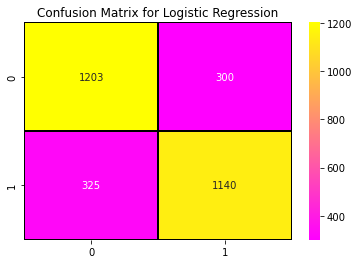

In [437]:
cm = confusion_matrix(y_test, predLR)
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", cmap="spring") 
plt.title('Confusion Matrix for Logistic Regression')
plt.show()

### Cross-validation for Logistic Regression

In [438]:
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score

# Predict using logistic regression
pred_lr = LR.predict(x_test)

# Calculate the accuracy score
lss = accuracy_score(y_test, pred_lr)

# Perform cross-validation for different folds
for j in range(2, 15):
    # Calculate cross-validation scores
    cv_scores = cross_val_score(LR, x, y, cv=j)
    mean_cv_score = cv_scores.mean()
    
    # Display the results
    print('At cv:', j)
    print('Cross-validation score is:', mean_cv_score * 100)
    print('Accuracy score is:', lss * 100)
    print('\n')

At cv: 2
Cross-validation score is: 72.77598059037607
Accuracy score is: 78.94204851752022


At cv: 3
Cross-validation score is: 73.06944359375287
Accuracy score is: 78.94204851752022


At cv: 4
Cross-validation score is: 71.26971289931257
Accuracy score is: 78.94204851752022


At cv: 5
Cross-validation score is: 72.20038922334666
Accuracy score is: 78.94204851752022


At cv: 6
Cross-validation score is: 72.13099019509714
Accuracy score is: 78.94204851752022


At cv: 7
Cross-validation score is: 73.90804464561886
Accuracy score is: 78.94204851752022


At cv: 8
Cross-validation score is: 72.56539205144506
Accuracy score is: 78.94204851752022


At cv: 9
Cross-validation score is: 73.97836416944698
Accuracy score is: 78.94204851752022


At cv: 10
Cross-validation score is: 73.79699931570508
Accuracy score is: 78.94204851752022


At cv: 11
Cross-validation score is: 74.6868799226975
Accuracy score is: 78.94204851752022


At cv: 12
Cross-validation score is: 73.98015347651268
Accuracy score

Select


At cv: 13


Cross-validation score is: 74.424699548325


Accuracy score is: 79.24528301886792


In [439]:
#using k-fold cross validation for Logistic Regression 
cvscore=cross_val_score(LR,x,y,cv=13)
print(cvscore)
print(cvscore.mean())
print('Difference between Accuracy score and cross validation score is -',abs(accuracy_score(y_test,predLR) - cvscore.mean()))

[0.8370565  0.6977661  0.66360053 0.67411301 0.75295664 0.73061761
 0.60446781 0.717477   0.77003942 0.79369251 0.84756899 0.81471748
 0.83157895]
0.7488963488271877
Difference between Accuracy score and cross validation score is - 0.04052413634801444


Logistic Regression has given us


Accuracy Score= 0.7924528301886793, 


cv score=0.7442469954832499,


Difference between Accuracy score and cross validation score is=0.048205834705429385

# DecisionTree Classifier

In [440]:
#checking accuracy for DecisionTreeclassifier
DTC=DecisionTreeClassifier()
DTC.fit(x_train, y_train)
predDTC=DTC.predict(x_test)
print('Accuracy Score',accuracy_score(y_test, predDTC))
print('Confusion Matrix',confusion_matrix(y_test, predDTC))
print('Classification Report',classification_report(y_test,predDTC))

Accuracy Score 0.8244609164420486
Confusion Matrix [[1212  291]
 [ 230 1235]]
Classification Report               precision    recall  f1-score   support

           0       0.84      0.81      0.82      1503
           1       0.81      0.84      0.83      1465

    accuracy                           0.82      2968
   macro avg       0.82      0.82      0.82      2968
weighted avg       0.83      0.82      0.82      2968



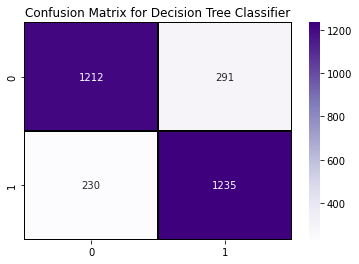

In [441]:
cm = confusion_matrix(y_test, predDTC)
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f",  cmap="Purples") 
plt.title('Confusion Matrix for Decision Tree Classifier')
plt.show()

### Cross-validation for DecisionTreeClassifier

In [442]:
#using k-fold cross validation for decision tree classifier 
cvscore=cross_val_score(DTC,x,y,cv=13)
print(cvscore)
print(cvscore.mean())
print('Difference between Accuracy score and cross validation score is -',abs(accuracy_score(y_test,predDTC) - cvscore.mean()))

[0.75032852 0.67542707 0.63337714 0.66754271 0.73718791 0.72273325
 0.66754271 0.80551905 0.82785808 0.70959264 0.87647832 0.87516426
 0.81184211]
0.7508149036799013
Difference between Accuracy score and cross validation score is - 0.07364601276214722


DecisionTreeClassifier has given us 


Accuracy Score= 0.8207547169811321,


cv score= 0.7318134300169711,


Difference between Accuracy score and cross validation score is=0.08894128696416104

# RandomForestClassifier

In [443]:
RFC=RandomForestClassifier()
RFC.fit(x_train, y_train)
predRFC=RFC.predict(x_test)
print('Accuracy Score:',accuracy_score(y_test, predRFC))
print('Confusion Matrix:',confusion_matrix(y_test, predRFC))
print(classification_report(y_test,predRFC))

Accuracy Score: 0.9110512129380054
Confusion Matrix: [[1340  163]
 [ 101 1364]]
              precision    recall  f1-score   support

           0       0.93      0.89      0.91      1503
           1       0.89      0.93      0.91      1465

    accuracy                           0.91      2968
   macro avg       0.91      0.91      0.91      2968
weighted avg       0.91      0.91      0.91      2968



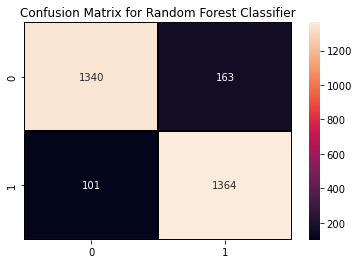

In [444]:
cm = confusion_matrix(y_test, predRFC)
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f") 
plt.title('Confusion Matrix for Random Forest Classifier')
plt.show()

### Cross-validation for RandomForestClassifier

In [445]:
#using k-fold cross validation for Random Forest classifier 
cvscore=cross_val_score(RFC,x,y,cv=13)
print(cvscore)
print(cvscore.mean())
print('Difference between Accuracy score and cross validation score is -',abs(accuracy_score(y_test,predRFC) - cvscore.mean()))

[0.87647832 0.77660972 0.73981603 0.69382392 0.83837057 0.78975033
 0.70827858 0.82917214 0.89881735 0.7739816  0.96057819 0.93166886
 0.92105263]
0.8260306330366499
Difference between Accuracy score and cross validation score is - 0.08502057990135548


RandomForestClassifier has given us 


Accuracy Score= 0.9080188679245284,


cv score= 0.8241086201301293,


Difference between Accuracy score and cross validation score is= 0.08391024779439904

# SupportVectorClassifier

In [446]:
#checking accuracy for support vector machine classifier

svc=SVC()
svc.fit(x_train,y_train)
predsvc= svc.predict(x_test)
print('Accuracy Score', accuracy_score(y_test,predsvc))
print('Confusion Matrix', confusion_matrix(y_test,predsvc))
print('Classification Report', classification_report(y_test,predsvc))

Accuracy Score 0.8591644204851752
Confusion Matrix [[1276  227]
 [ 191 1274]]
Classification Report               precision    recall  f1-score   support

           0       0.87      0.85      0.86      1503
           1       0.85      0.87      0.86      1465

    accuracy                           0.86      2968
   macro avg       0.86      0.86      0.86      2968
weighted avg       0.86      0.86      0.86      2968



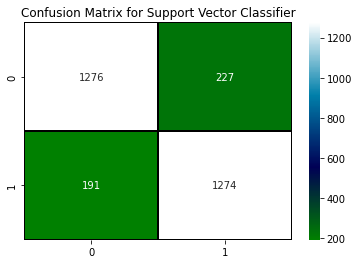

In [447]:
cm = confusion_matrix(y_test, predsvc)
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", cmap="ocean") 
plt.title('Confusion Matrix for Support Vector Classifier')
plt.show()

### Cross-validation for SupportVectorClassifier

In [448]:
#using k-fold cross validation for support vector classifier 
cvscore=cross_val_score(svc,x,y,cv=13)
print(cvscore)
print(cvscore.mean())
print('Difference between Accuracy score and cross validation score is -',abs(accuracy_score(y_test,predsvc) - cvscore.mean()))

[0.85545335 0.75032852 0.65045992 0.64914586 0.78318003 0.77266754
 0.63994744 0.77266754 0.81865966 0.78975033 0.89224704 0.85413929
 0.78552632]
0.7703209871945608
Difference between Accuracy score and cross validation score is - 0.0888434332906144


SupportVectorClassifier has given us


Accuracy Score= 0.8574797843665768,


cv score= 0.7732531508190269,


Difference between Accuracy score and cross validation score is=0.08422663354754989

# K-Neighbor Classifier

In [449]:
#checking accuracy for support k-Neighbors classifier

KNN=KNeighborsClassifier()
KNN.fit(x_train,y_train)
predKNN= KNN.predict(x_test)
print('Accuracy Score', accuracy_score(y_test,predKNN))
print('Confusion Matrix', confusion_matrix(y_test,predKNN))
print('Classification Report', classification_report(y_test,predKNN))

Accuracy Score 0.8433288409703504
Confusion Matrix [[1099  404]
 [  61 1404]]
Classification Report               precision    recall  f1-score   support

           0       0.95      0.73      0.83      1503
           1       0.78      0.96      0.86      1465

    accuracy                           0.84      2968
   macro avg       0.86      0.84      0.84      2968
weighted avg       0.86      0.84      0.84      2968



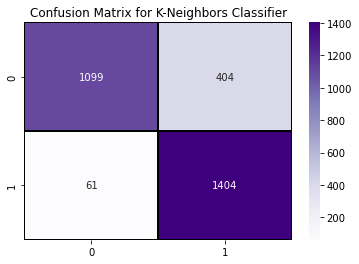

In [450]:
cm = confusion_matrix(y_test, predKNN)
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", cmap="Purples") 
plt.title('Confusion Matrix for K-Neighbors Classifier')
plt.show()

### Cross-validation for K-Neighbor Classifier

In [451]:
#using k-fold cross validation for k-Neighbour classifier 
cvscore=cross_val_score(KNN,x,y,cv=13)
print(cvscore)
print(cvscore.mean())
print('Difference between Accuracy score and cross validation score is -',abs(accuracy_score(y_test,predKNN) - cvscore.mean()))

[0.83968463 0.80157687 0.70565046 0.64520368 0.71616294 0.74901445
 0.63994744 0.73193167 0.79237845 0.76346912 0.88436268 0.86070959
 0.79473684]
0.763448371256657
Difference between Accuracy score and cross validation score is - 0.07988046971369345


K-NeighbourClassifier has given us


Accuracy Score= 0.8524258760107817,


cv score= 0.762841615815542,


Difference between Accuracy score and cross validation score is= 0.08958426019523968

# Gradient Boosting Classifier

In [452]:
#checking accuracy for gradient boosting classifier
GB=GradientBoostingClassifier()
GB.fit(x_train,y_train)
predGB=GB.predict(x_test)
print('Accuracy Score', accuracy_score(y_test,predGB))
print('Confusion Matrix', confusion_matrix(y_test,predGB))
print('Classification Report', classification_report(y_test,predGB))

Accuracy Score 0.8706199460916442
Confusion Matrix [[1304  199]
 [ 185 1280]]
Classification Report               precision    recall  f1-score   support

           0       0.88      0.87      0.87      1503
           1       0.87      0.87      0.87      1465

    accuracy                           0.87      2968
   macro avg       0.87      0.87      0.87      2968
weighted avg       0.87      0.87      0.87      2968



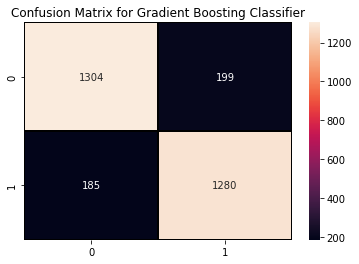

In [453]:
cm = confusion_matrix(y_test, predGB)
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f") 
plt.title('Confusion Matrix for Gradient Boosting Classifier')
plt.show()

### Cross-validation for Gradient Boosting Classifier

In [454]:
#using k-fold cross validation for Gradient Boosting classifier 
cvscore=cross_val_score(GB,x,y,cv=13)
print(cvscore)
print(cvscore.mean())
print('Difference between Accuracy score and cross validation score is -',abs(accuracy_score(y_test,predGB) - cvscore.mean()))

[0.78186597 0.62812089 0.6346912  0.65308804 0.78186597 0.70827858
 0.62812089 0.80683311 0.87647832 0.74244415 0.91327201 0.88436268
 0.90921053]
0.7652794107476313
Difference between Accuracy score and cross validation score is - 0.10534053534401289


Gradient Boosting Classifier has given us


Accuracy Score= 0.8733153638814016,


cv score= 0.7711433389903546,


Difference between Accuracy score and cross validation score is= 0.10217202489104704

# AdaBoost Classifier

In [455]:
#checking accuracy for AdaBoost Classifier
ABC=AdaBoostClassifier()
ABC.fit(x_train, y_train)
predABC=ABC.predict(x_test)
print('Accuracy Score', accuracy_score(y_test,predABC))
print('Confusion Matrix', confusion_matrix(y_test,predABC))
print('Classification Report', classification_report(y_test,predABC))

Accuracy Score 0.8423180592991913
Confusion Matrix [[1262  241]
 [ 227 1238]]
Classification Report               precision    recall  f1-score   support

           0       0.85      0.84      0.84      1503
           1       0.84      0.85      0.84      1465

    accuracy                           0.84      2968
   macro avg       0.84      0.84      0.84      2968
weighted avg       0.84      0.84      0.84      2968



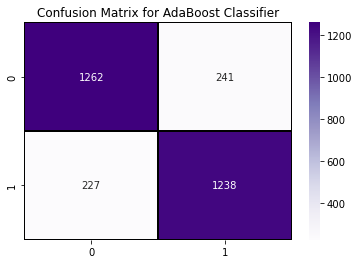

In [456]:
cm = confusion_matrix(y_test, predABC)
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f",cmap="Purples" ) 
plt.title('Confusion Matrix for AdaBoost Classifier')
plt.show()

### Cross-validation for AdaBoost Classifier

In [457]:
#using k-fold cross validation for Adaboost classifier 
cvscore=cross_val_score(ABC,x,y,cv=13)
print(cvscore)
print(cvscore.mean())
print('Difference between Accuracy score and cross validation score is -',abs(accuracy_score(y_test,predABC) - cvscore.mean()))

[0.77923784 0.62549277 0.55190539 0.63206307 0.78843627 0.717477
 0.54533509 0.73061761 0.80683311 0.69908016 0.86202365 0.86202365
 0.81052632]
0.723927072305245
Difference between Accuracy score and cross validation score is - 0.11839098699394635


AdaBoost Classifier has given us


Accuracy Score= 0.8349056603773585,


cv score= 0.734141365239643,


Difference between Accuracy score and cross validation score is -  0.10076429513771545

# Bagging Classifier

In [458]:
#checking accuracy for Bagging classifier

BC=BaggingClassifier()
BC.fit(x_train,y_train)
predBC= BC.predict(x_test)
print('Accuracy Score', accuracy_score(y_test,predBC))
print('Confusion Matrix', confusion_matrix(y_test,predBC))
print('Classification Report', classification_report(y_test,predBC))

Accuracy Score 0.8817385444743935
Confusion Matrix [[1342  161]
 [ 190 1275]]
Classification Report               precision    recall  f1-score   support

           0       0.88      0.89      0.88      1503
           1       0.89      0.87      0.88      1465

    accuracy                           0.88      2968
   macro avg       0.88      0.88      0.88      2968
weighted avg       0.88      0.88      0.88      2968



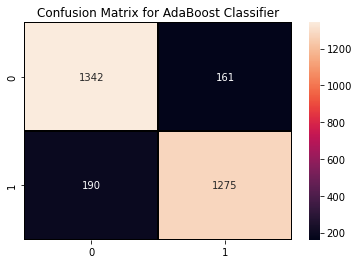

In [459]:
cm = confusion_matrix(y_test, predBC)
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f" ) 
plt.title('Confusion Matrix for AdaBoost Classifier')
plt.show()

### Cross-validation for Bagging Classifier

In [460]:
#using k-fold cross validation for Bagging classifier 
cvscore=cross_val_score(BC,x,y,cv=10)
print(cvscore)
print(cvscore.mean())
print('Difference between Accuracy score and cross validation score is -',abs(accuracy_score(y_test,predBC) - cvscore.mean()))

[0.80606061 0.72020202 0.70171891 0.77654196 0.60262892 0.80485339
 0.83316481 0.80889788 0.91911021 0.89079879]
0.786397748976111
Difference between Accuracy score and cross validation score is - 0.09534079549828245


Bagging Classifier has given us


Accuracy Score= 0.9046495956873315,


cv score= 0.8285563423366867,


Difference between Accuracy score and cross validation score is -0.07609325335064476

# Selection for the final model

After trying different different classification model here we reach at the conclusion that RandomForestClassifier is our final model because when we have applied the RandomForestClassifier we got an accuracy of 0.9110512129380054 and to over come overfitting and underfitting issue we use cross validation and get cross validation score of 0.8260306330366499 and we find Difference between Accuracy score and cross validation score that is equal to  0.08502057990135548. so we select that model as our final model which has higher accuracy score and higher cross validation score and has lowest difference between between accuracy score and cross validation score. here RandomForestClassifier fullfills all our requriment so we select RandomForestClassifier as our final model and now perfrom hyperparameter tuning on it. 

# Select RandomForestClassifier as our final model

# Perfrom Hyperparmeter Tuning for RandomForestClassifier

In [461]:
from sklearn.model_selection import GridSearchCV

parameter = {'criterion':['gini','entropy'],
             'max_depth': [10,15,20,25],
             'n_estimators':[100,200,300,400],
             'max_features': ["auto","sqrt","log2"]}

In [462]:
GCV=GridSearchCV(RandomForestClassifier(),parameter, cv=13)

In [463]:
GCV.fit(x_train,y_train)

GridSearchCV(cv=13, estimator=RandomForestClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [10, 15, 20, 25],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [100, 200, 300, 400]})

In [464]:
GCV.best_params_

{'criterion': 'entropy',
 'max_depth': 25,
 'max_features': 'log2',
 'n_estimators': 400}

# Final Model

In [476]:
# Define and train the Extra Trees Classifier
final_model = RandomForestClassifier(criterion='entropy', max_depth=25, n_estimators=300, max_features='log2')
final_model.fit(x_train, y_train)

# Make predictions
pred = final_model.predict(x_test)

# Calculate and print the accuracy score
accuracy = accuracy_score(y_test, pred)
print('Accuracy:', accuracy * 100)

Accuracy: 90.97035040431267


The accuracy of our final model is slightly increse by some percentage. Here we get the accuracy of 90.97%

# Auc-Roc curve

In [466]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

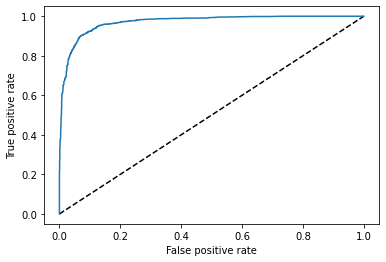

Auc score:
 0.9102457201637681


In [467]:
y_pred_prob=final_model.predict_proba(x_test)[:,1]
fpr,tpr,thresholds=roc_curve(y_test,y_pred_prob)
roc_auc=auc(fpr,tpr)

plt.plot([0,1],[0,1], 'k--')
plt.plot(fpr,tpr)
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.show()
auc_score=roc_auc_score(y_test, final_model.predict(x_test))
print('Auc score:' '\n', auc_score)

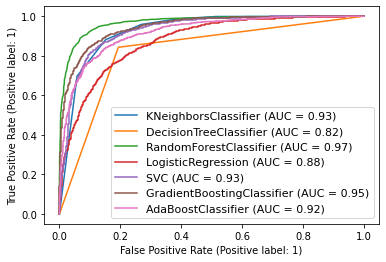

In [468]:
# Plotting for all the models used here
from sklearn import datasets 
from sklearn import metrics
from sklearn import model_selection
from sklearn.metrics import plot_roc_curve 


disp = plot_roc_curve(KNN,x_test,y_test)
plot_roc_curve(DTC, x_test, y_test, ax=disp.ax_)     # ax_=Axes with confusion matrix
plot_roc_curve(RFC, x_test, y_test, ax=disp.ax_)
plot_roc_curve(LR, x_test, y_test, ax=disp.ax_)
plot_roc_curve(svc, x_test, y_test, ax=disp.ax_)
plot_roc_curve(GB, x_test, y_test, ax=disp.ax_)
plot_roc_curve(ABC, x_test, y_test, ax=disp.ax_)

plt.legend(prop={'size':11}, loc='lower right')
plt.show()

# Saving best model

In [469]:
import joblib

joblib.dump(final_model, 'Rainfall Weather Forecasting.pkl')

['Rainfall Weather Forecasting.pkl']

# Predicting save model

In [470]:
model=joblib.load('Rainfall Weather Forecasting.pkl')

#Predict

prediction = model.predict(x_test)

prediction

array([1, 0, 0, ..., 1, 0, 0])

In [471]:
pd.DataFrame([model.predict(x_test)[:],y_test[:]],index=["Predicted","Original"]).T

,Predicted,Original
0,1,1
1,0,0
2,0,0
3,1,1
4,1,1
...,...,...
2963,1,1
2964,0,0
2965,1,1
2966,0,0


# Conclusion

Here we can see that the predicted values and original values are almost similiar so our model is working fine. RandomForestClassifier is wroking very well here.

# Now Lets predict how much rainfall could be there 

In [472]:
df

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,1,13.4,22.9,0.6,1.663103,9.0,13,44.000000,13,14,...,1007.1,8.000000,4.320988,16.9,21.8,0,0,1,12,2008
1,1,7.4,25.1,0.0,1.663103,9.0,14,44.000000,6,15,...,1007.8,4.336806,4.320988,17.2,24.3,0,0,2,12,2008
2,1,12.9,25.7,0.0,1.663103,9.0,15,46.000000,13,15,...,1008.7,4.336806,2.000000,21.0,23.2,0,0,3,12,2008
3,1,9.2,28.0,0.0,1.663103,9.0,4,24.000000,9,0,...,1012.8,4.336806,4.320988,18.1,26.5,0,0,4,12,2008
4,1,17.5,32.3,1.0,1.663103,9.0,13,41.000000,1,7,...,1006.0,7.000000,8.000000,17.8,29.7,0,0,5,12,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.4,0.0,1.663103,9.0,0,31.000000,9,1,...,1020.3,4.336806,4.320988,10.1,22.4,0,0,21,6,2017
8421,9,3.6,25.3,0.0,1.663103,9.0,6,22.000000,9,3,...,1019.1,4.336806,4.320988,10.9,24.5,0,0,22,6,2017
8422,9,5.4,26.9,0.0,1.663103,9.0,3,37.000000,9,14,...,1016.8,4.336806,4.320988,12.5,26.1,0,0,23,6,2017
8423,9,7.8,27.0,0.0,1.663103,9.0,9,28.000000,10,3,...,1016.5,3.000000,2.000000,15.1,26.0,0,0,24,6,2017


Let's check correlation with Target variable 

In [473]:
cor['Rainfall'].sort_values(ascending=False)

Rainfall         1.000000
RainToday        0.703806
Humidity9am      0.293520
Humidity3pm      0.286583
RainTomorrow     0.261425
Cloud9am         0.228667
Cloud3pm         0.184469
WindDir9am       0.121385
WindGustSpeed    0.099116
MinTemp          0.086260
WindDir3pm       0.079713
WindGustDir      0.073570
WindSpeed9am     0.041979
WindSpeed3pm     0.033374
Location         0.017224
Year             0.004645
Month           -0.000151
Day             -0.010499
Temp9am         -0.038111
Pressure3pm     -0.050933
Evaporation     -0.107047
Pressure9am     -0.111669
MaxTemp         -0.141079
Temp3pm         -0.150573
Sunshine        -0.156651
Name: Rainfall, dtype: float64

Rainfall column is highly positively and negatively corelated with "RinToday" & "sunshine" columns and very less corelated with "year", "month" column.

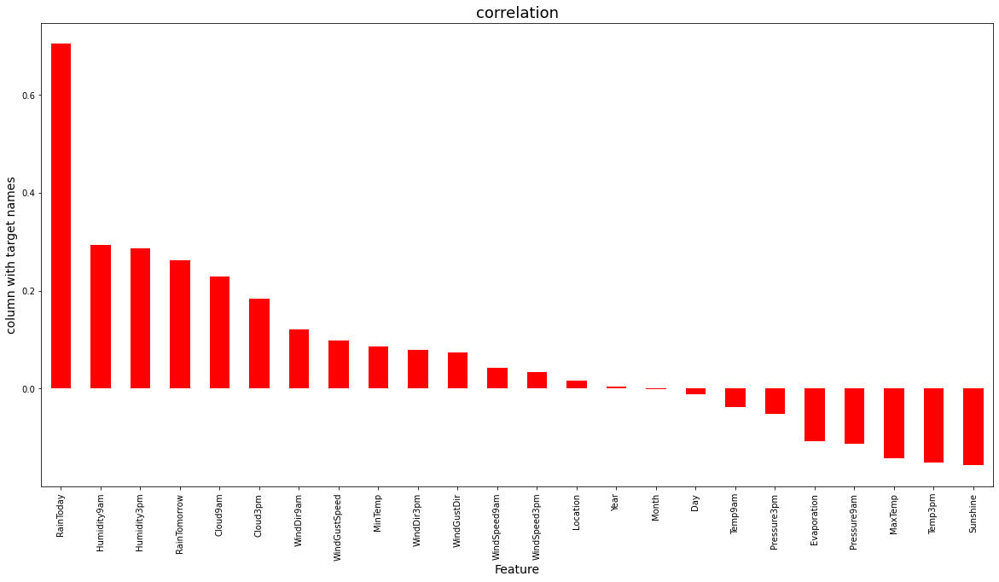

In [474]:
plt.figure(figsize=(20,10))
df_new.corr()['Rainfall'].sort_values(ascending=False).drop(['Rainfall']).plot(kind='bar',color='r')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('column with target names',fontsize=14)
plt.title('correlation',fontsize=18)
plt.show()

month, year, day is very less correlated with target (Rainfall) column

# Spliting feature and label variables

In [478]:
x1 = df.drop("Rainfall", axis=1)
y1 = df["Rainfall"]

In [479]:
x1

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,1,13.4,22.9,1.663103,9.0,13,44.000000,13,14,20.0,...,1007.1,8.000000,4.320988,16.9,21.8,0,0,1,12,2008
1,1,7.4,25.1,1.663103,9.0,14,44.000000,6,15,4.0,...,1007.8,4.336806,4.320988,17.2,24.3,0,0,2,12,2008
2,1,12.9,25.7,1.663103,9.0,15,46.000000,13,15,19.0,...,1008.7,4.336806,2.000000,21.0,23.2,0,0,3,12,2008
3,1,9.2,28.0,1.663103,9.0,4,24.000000,9,0,11.0,...,1012.8,4.336806,4.320988,18.1,26.5,0,0,4,12,2008
4,1,17.5,32.3,1.663103,9.0,13,41.000000,1,7,7.0,...,1006.0,7.000000,8.000000,17.8,29.7,0,0,5,12,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.4,1.663103,9.0,0,31.000000,9,1,13.0,...,1020.3,4.336806,4.320988,10.1,22.4,0,0,21,6,2017
8421,9,3.6,25.3,1.663103,9.0,6,22.000000,9,3,13.0,...,1019.1,4.336806,4.320988,10.9,24.5,0,0,22,6,2017
8422,9,5.4,26.9,1.663103,9.0,3,37.000000,9,14,9.0,...,1016.8,4.336806,4.320988,12.5,26.1,0,0,23,6,2017
8423,9,7.8,27.0,1.663103,9.0,9,28.000000,10,3,13.0,...,1016.5,3.000000,2.000000,15.1,26.0,0,0,24,6,2017


In [480]:
y1

0       0.6
1       0.0
2       0.0
3       0.0
4       1.0
       ... 
8420    0.0
8421    0.0
8422    0.0
8423    0.0
8424    0.0
Name: Rainfall, Length: 6305, dtype: float64

In [481]:
x1.shape

(6305, 24)

In [482]:
y1.shape

(6305,)

# Check for multicolinearity

In [483]:
v=x1
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
scaled=sc.fit_transform(v)
VIF= pd.DataFrame()
VIF['features']=v.columns
VIF['vif']= [variance_inflation_factor(scaled,i) for i in range(len(v.columns))]
VIF

,features,vif
0,Location,1.646847
1,MinTemp,9.206511
2,MaxTemp,26.188983
3,Evaporation,1.641545
4,Sunshine,1.850982
5,WindGustDir,1.582363
6,WindGustSpeed,2.320802
7,WindDir9am,1.330977
8,WindDir3pm,1.423992
9,WindSpeed9am,2.056120


In [484]:
x1.drop("Temp3pm",axis=1,inplace=True)

In [485]:
v=x1
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
scaled=sc.fit_transform(v)
VIF= pd.DataFrame()
VIF['features']=v.columns
VIF['vif']= [variance_inflation_factor(scaled,i) for i in range(len(v.columns))]
VIF

,features,vif
0,Location,1.646814
1,MinTemp,9.163558
2,MaxTemp,9.605010
3,Evaporation,1.641364
4,Sunshine,1.849624
5,WindGustDir,1.576730
6,WindGustSpeed,2.312537
7,WindDir9am,1.329427
8,WindDir3pm,1.423612
9,WindSpeed9am,2.054726


In [486]:
x1.drop("Pressure9am",axis=1,inplace=True)

In [487]:
v=x1
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
scaled=sc.fit_transform(v)
VIF= pd.DataFrame()
VIF['features']=v.columns
VIF['vif']= [variance_inflation_factor(scaled,i) for i in range(len(v.columns))]
VIF

,features,vif
0,Location,1.645711
1,MinTemp,9.066303
2,MaxTemp,9.268386
3,Evaporation,1.631864
4,Sunshine,1.846817
5,WindGustDir,1.564033
6,WindGustSpeed,2.290503
7,WindDir9am,1.306327
8,WindDir3pm,1.347911
9,WindSpeed9am,2.053510


In [488]:
x1.drop("Temp9am",axis=1,inplace=True)

In [489]:
v=x1
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
scaled=sc.fit_transform(v)
VIF= pd.DataFrame()
VIF['features']=v.columns
VIF['vif']= [variance_inflation_factor(scaled,i) for i in range(len(v.columns))]
VIF

,features,vif
0,Location,1.641737
1,MinTemp,4.799185
2,MaxTemp,5.619397
3,Evaporation,1.627333
4,Sunshine,1.841338
5,WindGustDir,1.562594
6,WindGustSpeed,2.257139
7,WindDir9am,1.305665
8,WindDir3pm,1.347807
9,WindSpeed9am,2.022929


The vif value for each column is less than 10 so we can say that multicolinearity is removed from the dataset.

In [490]:
x1.shape

(6305, 21)

In [491]:
x1

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Humidity9am,Humidity3pm,Pressure3pm,Cloud9am,Cloud3pm,RainToday,RainTomorrow,Day,Month,Year
0,1,13.4,22.9,1.663103,9.0,13,44.000000,13,14,20.0,...,71.0,22.0,1007.1,8.000000,4.320988,0,0,1,12,2008
1,1,7.4,25.1,1.663103,9.0,14,44.000000,6,15,4.0,...,44.0,25.0,1007.8,4.336806,4.320988,0,0,2,12,2008
2,1,12.9,25.7,1.663103,9.0,15,46.000000,13,15,19.0,...,38.0,30.0,1008.7,4.336806,2.000000,0,0,3,12,2008
3,1,9.2,28.0,1.663103,9.0,4,24.000000,9,0,11.0,...,45.0,16.0,1012.8,4.336806,4.320988,0,0,4,12,2008
4,1,17.5,32.3,1.663103,9.0,13,41.000000,1,7,7.0,...,82.0,33.0,1006.0,7.000000,8.000000,0,0,5,12,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.4,1.663103,9.0,0,31.000000,9,1,13.0,...,51.0,24.0,1020.3,4.336806,4.320988,0,0,21,6,2017
8421,9,3.6,25.3,1.663103,9.0,6,22.000000,9,3,13.0,...,56.0,21.0,1019.1,4.336806,4.320988,0,0,22,6,2017
8422,9,5.4,26.9,1.663103,9.0,3,37.000000,9,14,9.0,...,53.0,24.0,1016.8,4.336806,4.320988,0,0,23,6,2017
8423,9,7.8,27.0,1.663103,9.0,9,28.000000,10,3,13.0,...,51.0,24.0,1016.5,3.000000,2.000000,0,0,24,6,2017


In [492]:
y1

0       0.6
1       0.0
2       0.0
3       0.0
4       1.0
       ... 
8420    0.0
8421    0.0
8422    0.0
8423    0.0
8424    0.0
Name: Rainfall, Length: 6305, dtype: float64

# Check for the prescence of outliers

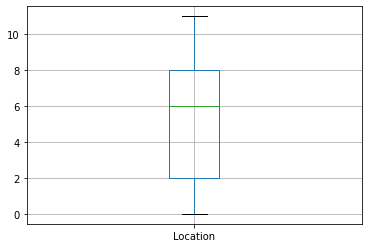

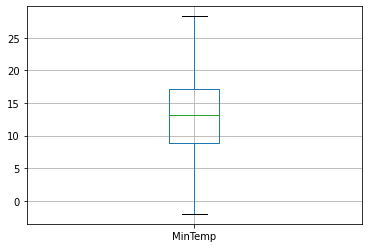

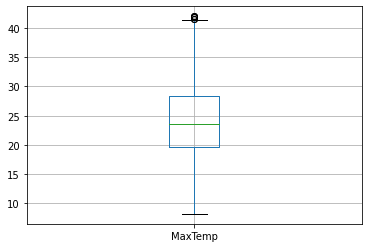

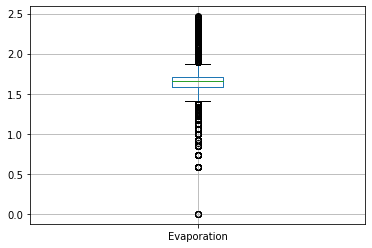

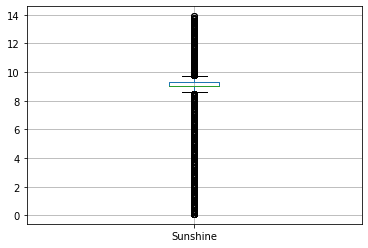

...

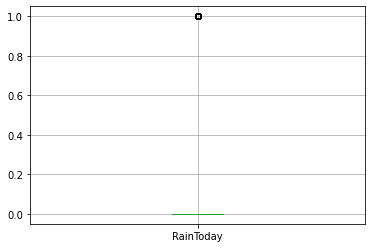

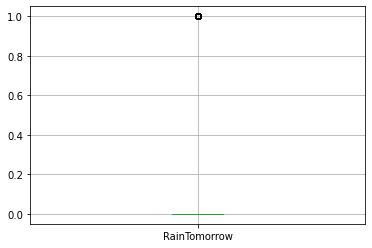

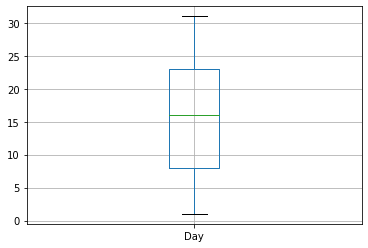

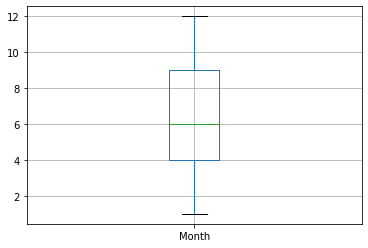

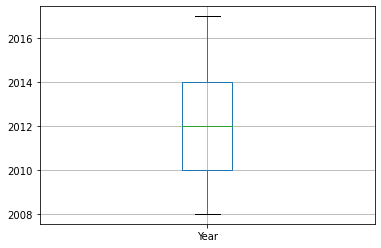

In [493]:
for i in x1:
    x1.boxplot(i)
    plt.show()

In [494]:
#Removing outliers
from scipy.stats import zscore
z1=np.abs(zscore(x1))

z1

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Humidity9am,Humidity3pm,Pressure3pm,Cloud9am,Cloud3pm,RainToday,RainTomorrow,Day,Month,Year
0,1.390820,0.076961,0.200778,0.054779,0.154322,1.224412,0.482848,1.321318,1.371163,0.870756,...,0.214128,1.561537,1.441508,1.523901,0.038815,0.526886,0.524183,1.671897,1.653994,1.771042
1,1.390820,1.005480,0.164759,0.054779,0.154322,1.415150,0.482848,0.221198,1.594258,0.905978,...,1.387834,1.393832,1.317652,0.034278,0.038815,0.526886,0.524183,1.558125,1.653994,1.771042
2,1.390820,0.013242,0.264451,0.054779,0.154322,1.605888,0.646734,1.321318,1.594258,0.759710,...,1.743826,1.114323,1.158408,0.034278,0.969817,0.526886,0.524183,1.444353,1.653994,1.771042
3,1.390820,0.680748,0.646603,0.054779,0.154322,0.492227,1.156011,0.439880,1.752177,0.128657,...,1.328502,1.896947,0.432963,0.034278,0.038815,0.526886,0.524183,1.330582,1.653994,1.771042
4,1.390820,0.816629,1.361061,0.054779,0.154322,1.224412,0.237020,1.322996,0.190507,0.572841,...,0.866779,0.946618,1.636140,1.117255,1.637603,0.526886,0.524183,1.216810,1.653994,1.771042
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,1.194987,1.835352,0.117701,0.054779,0.154322,1.255179,0.582410,0.439880,1.529081,0.093435,...,0.972511,1.449733,0.894069,0.034278,0.038815,0.526886,0.524183,0.603542,0.135987,2.153732
8421,1.194987,1.691026,0.197990,0.054779,0.154322,0.110752,1.319897,0.439880,1.082890,0.093435,...,0.675851,1.617439,0.681744,0.034278,0.038815,0.526886,0.524183,0.717314,0.135987,2.153732
8422,1.194987,1.366294,0.463834,0.054779,0.154322,0.682965,0.090752,0.439880,1.371163,0.350749,...,0.853847,1.449733,0.274787,0.034278,0.038815,0.526886,0.524183,0.831086,0.135987,2.153732
8423,1.194987,0.933317,0.480450,0.054779,0.154322,0.461461,0.828239,0.660240,1.082890,0.093435,...,0.972511,1.449733,0.221706,0.509329,0.969817,0.526886,0.524183,0.944858,0.135987,2.153732


In [495]:
#threshold value =3
threshold=3

print(np.where(z1>3))

(array([ 303,  341,  343,  347,  718,  892,  893,  910,  919,  938,  939,
        940,  967, 1088, 1114, 1127, 1204, 1239, 1252, 1266, 1279, 1286,
       1291, 1295, 1305, 1306, 1308, 1323, 1326, 1327, 1347, 1358, 1359,
       1371, 1372, 1372, 1382, 1398, 1409, 1412, 1413, 1418, 1435, 1439,
       1551, 1562, 1565, 1587, 1600, 1979, 2182, 2203, 2417, 2424, 2726,
       2785, 2884, 2884, 2885, 2900, 2900, 2908, 2925, 2935, 2944, 2947,
       2954, 2983, 3007, 3036, 3042, 3143, 3290, 3320, 3387, 3388, 3423,
       3465, 3484, 3488, 3514, 3540, 3557, 3557, 3569, 3577, 3583, 3588,
       3603, 3613, 3614, 3623, 3630, 3631, 3643, 3646, 3651, 3664, 3665,
       3667, 3671, 3690, 3692, 3693, 3694, 3694, 3697, 3697, 3698, 3701,
       3702, 3703, 3711, 3715, 3716, 3716, 3718, 3723, 3729, 3730, 3732,
       3732, 3733, 3746, 3746, 3747, 3759, 3767, 3774, 3816, 3821, 3826,
       3827, 3860, 3868, 3882, 3900, 3903, 3904, 3914, 3915, 3917, 3919,
       3925, 3926, 3930, 3931, 3935, 3936, 3938, 3

In [496]:
x1_new=x1[(z1<3).all(axis=1)]

x1_new

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Humidity9am,Humidity3pm,Pressure3pm,Cloud9am,Cloud3pm,RainToday,RainTomorrow,Day,Month,Year
0,1,13.4,22.9,1.663103,9.0,13,44.000000,13,14,20.0,...,71.0,22.0,1007.1,8.000000,4.320988,0,0,1,12,2008
1,1,7.4,25.1,1.663103,9.0,14,44.000000,6,15,4.0,...,44.0,25.0,1007.8,4.336806,4.320988,0,0,2,12,2008
2,1,12.9,25.7,1.663103,9.0,15,46.000000,13,15,19.0,...,38.0,30.0,1008.7,4.336806,2.000000,0,0,3,12,2008
3,1,9.2,28.0,1.663103,9.0,4,24.000000,9,0,11.0,...,45.0,16.0,1012.8,4.336806,4.320988,0,0,4,12,2008
4,1,17.5,32.3,1.663103,9.0,13,41.000000,1,7,7.0,...,82.0,33.0,1006.0,7.000000,8.000000,0,0,5,12,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.4,1.663103,9.0,0,31.000000,9,1,13.0,...,51.0,24.0,1020.3,4.336806,4.320988,0,0,21,6,2017
8421,9,3.6,25.3,1.663103,9.0,6,22.000000,9,3,13.0,...,56.0,21.0,1019.1,4.336806,4.320988,0,0,22,6,2017
8422,9,5.4,26.9,1.663103,9.0,3,37.000000,9,14,9.0,...,53.0,24.0,1016.8,4.336806,4.320988,0,0,23,6,2017
8423,9,7.8,27.0,1.663103,9.0,9,28.000000,10,3,13.0,...,51.0,24.0,1016.5,3.000000,2.000000,0,0,24,6,2017


In [497]:
x1_new.shape

(6033, 21)

In [498]:
x1.shape

(6305, 21)

In [499]:
Dataloss1=(((6305-6033)/6305)*100)
Dataloss1

4.314036478984932

Dataloss is 4.31% which is less than 10% so we can further proceed with the data.

# Check for skewness

In [500]:
x1.skew()

Location        -0.005041
MinTemp         -0.073640
MaxTemp          0.263690
Evaporation     -0.574230
Sunshine        -1.358828
WindGustDir      0.109246
WindGustSpeed    0.475266
WindDir9am       0.214975
WindDir3pm      -0.128511
WindSpeed9am     0.674698
WindSpeed3pm     0.339786
Humidity9am     -0.224089
Humidity3pm      0.138110
Pressure3pm      0.086202
Cloud9am        -0.190400
Cloud3pm        -0.138218
RainToday        1.371384
RainTomorrow     1.383878
Day              0.005324
Month            0.030646
Year             0.338266
dtype: float64

In [501]:
skewed_col1=['Sunshine','RainToday','RainTomorrow','MinTemp']

In [502]:
# Lets remove the skewness from given columns by Power Transform Method

from sklearn.preprocessing import PowerTransformer
PT = PowerTransformer(method='yeo-johnson')

In [503]:
#Removing skewness using yeo-johnson
x1[['Sunshine','RainToday','RainTomorrow','MinTemp']] = PT.fit_transform(x1[['Sunshine','RainToday','RainTomorrow','MinTemp']].values)

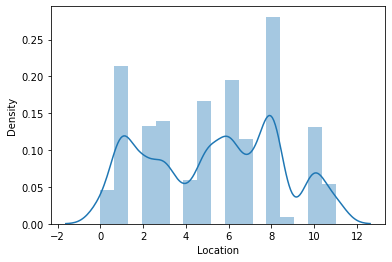

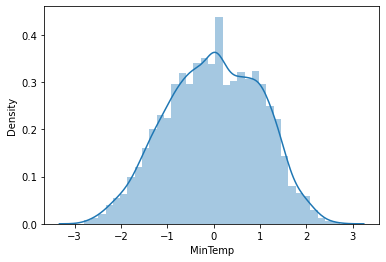

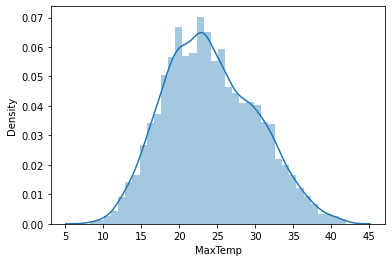

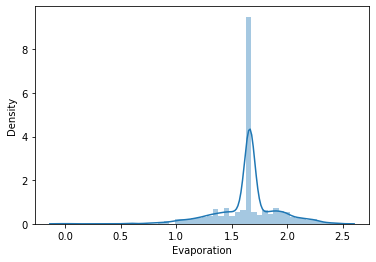

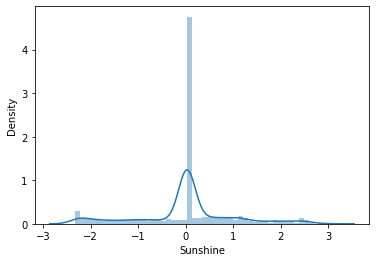

...

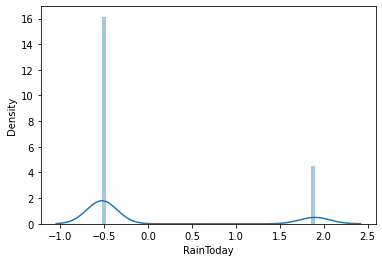

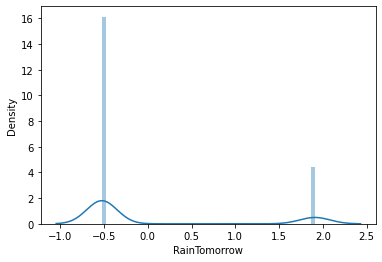

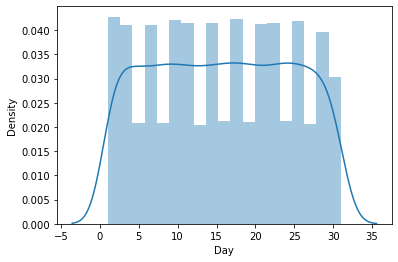

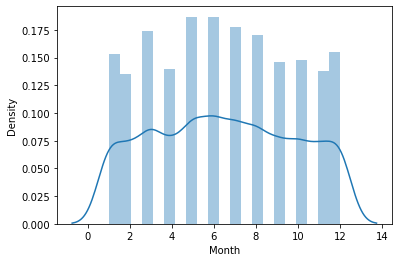

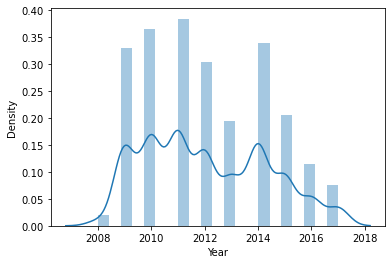

In [505]:
for i in x1:
    sns.distplot(x1[i])
    plt.show()

Here we can see that the data is distributed normaly so we can say that skewness is removed 

# Modeling

In [506]:
from sklearn.linear_model import LinearRegression
lr=LinearRegression()
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

In [520]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor

In [532]:
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score

# For best random state 

In [507]:
for i in range(0,100):
    x_train1,x_test1,y_train1,y_test1=train_test_split(x1,y1,test_size=0.2,random_state=i)
    lr.fit(x_train1,y_train1)
    pred_train=lr.predict(x_train1)
    pred_test=lr.predict(x_test1)
    print (f"At random state {i},the training accuracy is :- {r2_score(y_train1,pred_train)}")
    print (f"At random state {i},the testing accuracy is :- {r2_score(y_test1,pred_test)}")
    print ("\n\n")

At random state 0,the training accuracy is :- 0.5080824183618766
At random state 0,the testing accuracy is :- 0.48973489487523636



At random state 1,the training accuracy is :- 0.5057643709466337
At random state 1,the testing accuracy is :- 0.5004177240118934



At random state 2,the training accuracy is :- 0.507226268171233
At random state 2,the testing accuracy is :- 0.4963371652278653



At random state 3,the training accuracy is :- 0.5037606360131168
At random state 3,the testing accuracy is :- 0.5096350282007415



At random state 4,the training accuracy is :- 0.5127862981212731
At random state 4,the testing accuracy is :- 0.4783285570810125



At random state 5,the training accuracy is :- 0.5008193485985938
At random state 5,the testing accuracy is :- 0.5200935269232193



At random state 6,the training accuracy is :- 0.5000574218286211
At random state 6,the testing accuracy is :- 0.5269579438303544



At random state 7,the training accuracy is :- 0.50679825094949
At random sta

At random state 69,the testing accuracy is :- 0.5195676616414464



At random state 70,the training accuracy is :- 0.5070570989290804
At random state 70,the testing accuracy is :- 0.49640685852956956



At random state 71,the training accuracy is :- 0.5012817363483146
At random state 71,the testing accuracy is :- 0.5194601862629736



At random state 72,the training accuracy is :- 0.5021213828691347
At random state 72,the testing accuracy is :- 0.5118488924066786



At random state 73,the training accuracy is :- 0.506092478152953
At random state 73,the testing accuracy is :- 0.5009213723859938



At random state 74,the training accuracy is :- 0.5052587476621185
At random state 74,the testing accuracy is :- 0.5041701752631534



At random state 75,the training accuracy is :- 0.500525209889038
At random state 75,the testing accuracy is :- 0.5241234002766343



At random state 76,the training accuracy is :- 0.510930888664795
At random state 76,the testing accuracy is :- 0.4779273176956014

# Linear Regression 

In [509]:
x_train1,x_test1,y_train1,y_test1=train_test_split(x1,y1,test_size=0.2,random_state=8)

In [510]:
# train the model
lr.fit(x_train1,y_train1)

LinearRegression()

In [511]:
# predict the  data with x_test

pred_test=lr.predict(x_test1)

In [514]:
print (r2_score(y_test1,pred_test))

0.5041836244089188


In [515]:
pred_lr=lr.predict(x_test1)
from sklearn.model_selection import cross_val_score
lss=r2_score(y_test1,pred_lr)

In [516]:
for i in range(4,10):
    lsscore=cross_val_score(lr,x1,y1,cv=i)
    lsc=lsscore.mean()
    print ("At cv:-",i)
    print ("Cross validation score is :-",lsc*100)
    print ("Accuracy_score is :-",lss*100)
    print ("\n")

At cv:- 4
Cross validation score is :- 49.57254739713042
Accuracy_score is :- 50.41836244089188


At cv:- 5
Cross validation score is :- 49.68982134379233
Accuracy_score is :- 50.41836244089188


At cv:- 6
Cross validation score is :- 49.282244659568164
Accuracy_score is :- 50.41836244089188


At cv:- 7
Cross validation score is :- 49.86377970104571
Accuracy_score is :- 50.41836244089188


At cv:- 8
Cross validation score is :- 49.736836399926496
Accuracy_score is :- 50.41836244089188


At cv:- 9
Cross validation score is :- 49.21892223020554
Accuracy_score is :- 50.41836244089188




In [517]:
# I will take CV as 7 bcz its close to accuracy score
lsscore_selected= cross_val_score(lr,x1,y1,cv=7).mean()
print ("The cv score is :- ",lsscore_selected,"\nThe accuracy_score is:",lss)

The cv score is :-  0.4986377970104571 
The accuracy_score is: 0.5041836244089188


In [518]:
from sklearn import metrics
MAE= metrics.mean_absolute_error(y_test1,pred_test)
MSE= metrics.mean_squared_error(y_test1,pred_test)

In [519]:
print("mean absolute error:",MAE)
print("mean squared error:",MSE)

from math import sqrt
rmse = sqrt(MSE)
print("Root Mean Squared Error:",rmse)

mean absolute error: 1.3998745341438137
mean squared error: 9.962072121994686
Root Mean Squared Error: 3.156275039028552


In [559]:
print('Difference between Accuracy score and cross validation score is -',abs(lss - lsscore_selected))

Difference between Accuracy score and cross validation score is - 0.005545827398461767


# Lasso

In [537]:
ls=Lasso()
ls.fit(x_train1, y_train1)
ls.score(x_train1, y_train1)
ls_pred=ls.predict(x_test1)

lsd=r2_score(y_test1, ls_pred)
print('R2 score:', lsd*100)

rdscore= cross_val_score(ls,x1,y1,cv=7,scoring='r2')
lsc=rdscore.mean()
print('Cross val Score :', lsc*100) 

R2 score: 44.451846911568424
Cross val Score : 44.52472444516113


In [533]:
print('Error:')

print('Mean Absolute Error:',mean_absolute_error(y_test1,ls_pred))
print('Mean Squared Error:', mean_squared_error(y_test1,ls_pred))
print('Root Mean Square Error:', np.sqrt(mean_squared_error(y_test1,ls_pred)))

Error:
Mean Absolute Error: 1.5936301482488169
Mean Squared Error: 11.160880006249462
Root Mean Square Error: 3.3407903265918173


In [558]:
print('Difference between Accuracy score and cross validation score is -',abs(lsd - lsc))

Difference between Accuracy score and cross validation score is - 0.0007287753359270233


# Ridge

In [538]:
rd= Ridge()
rd.fit(x_train1, y_train1)
rd.score(x_train1, y_train1)
rd_pred= rd.predict(x_test1)

rds=r2_score(y_test1, rd_pred)
print('r2 score: ', rds*100)

rdcvscore= cross_val_score(rd,x1,y1,cv=7, scoring='r2')
rdcv=rdcvscore.mean()
print('Cross val Score', rdcv*100)

r2 score:  50.41871127186628
Cross val Score 49.86400202335312


In [539]:
print('Error:')

print('Mean Absolute Error:',mean_absolute_error(y_test1,rd_pred))
print('Mean Squared Error:', mean_squared_error(y_test1,rd_pred))
print('Root Mean Square Error:', np.sqrt(mean_squared_error(y_test1,rd_pred)))

Error:
Mean Absolute Error: 1.3998935501499532
Mean Squared Error: 9.962002033964188
Root Mean Square Error: 3.1562639360427682


In [557]:
print('Difference between Accuracy score and cross validation score is -',abs(rds - rdcv))

Difference between Accuracy score and cross validation score is - 0.005547092485131522


# K-Neighbour Regressor 

In [540]:
kn=KNeighborsRegressor()
kn.fit(x_train1, y_train1)
kn.score(x_train1,y_train1)
kn_pred=kn.predict(x_test1)

kn_score= r2_score(y_test1, kn_pred)
print('R2 Score:', kn_score*100)

kn_cvscore=cross_val_score(kn,x1,y1, cv=7, scoring='r2')
cv_mean=kn_cvscore.mean()
print('Cross val Score :',cv_mean*100 )

R2 Score: 6.007935171570877
Cross val Score : 8.631669126304843


In [541]:
print('Error:')

print('Mean Absolute Error:',mean_absolute_error(y_test1,kn_pred))
print('Mean Squared Error:', mean_squared_error(y_test1,kn_pred))
print('Root Mean Square Error:', np.sqrt(mean_squared_error(y_test1,kn_pred)))

Error:
Mean Absolute Error: 2.0396193497224426
Mean Squared Error: 18.885131165741477
Root Mean Square Error: 4.345702608985281


In [556]:
print('Difference between Accuracy score and cross validation score is -',abs(kn_score - cv_mean))

Difference between Accuracy score and cross validation score is - 0.026237339547339658


# DecisionTreeRegressor 

In [534]:
dt=DecisionTreeRegressor()
dt.fit(x_train1, y_train1)
dt.score(x_train1, y_train1)
dt_pred=dt.predict(x_test1)

dt_score=r2_score(y_test1, dt_pred)
print('R2 Score:', dt_score*100)

dtcvscore=cross_val_score(dt,x1,y1,cv=7, scoring='r2')
dtcv=dtcvscore.mean()
print('Cross Val Score:', dtcv*100)

R2 Score: 0.36540936462272633
Cross Val Score: -0.04042404160119314


In [535]:
print('Error:')

print('Mean Absolute Error:',mean_absolute_error(y_test1,dt_pred))
print('Mean Squared Error:', mean_squared_error(y_test1,dt_pred))
print('Root Mean Square Error:', np.sqrt(mean_squared_error(y_test1,dt_pred)))

Error:
Mean Absolute Error: 1.528152260111023
Mean Squared Error: 20.018842188739097
Root Mean Square Error: 4.474242079809618


In [555]:
print('Difference between Accuracy score and cross validation score is -',abs(dt_score - dtcv))

Difference between Accuracy score and cross validation score is - 0.055166965709212264


# RandomForestRegressor

In [544]:
rf=RandomForestRegressor()
rf.fit(x_train1, y_train1)
rf.score(x_train1,y_train1)
rf_pred=rf.predict(x_test1)

rf_score= r2_score(y_test1, rf_pred)
print('R2 score:', rf_score*100)

rfcv=cross_val_score(rf,x1,y1, cv=7, scoring='r2')
rfcvscore=rfcv.mean()
print('Cross val Score :',rfcvscore*100 )

R2 score: 45.88832914730965
Cross val Score : 47.72161427946375


In [545]:
print('Error:')

print('Mean Absolute Error:',mean_absolute_error(y_test1,rf_pred))
print('Mean Squared Error:', mean_squared_error(y_test1,rf_pred))
print('Root Mean Square Error:', np.sqrt(mean_squared_error(y_test1,rf_pred)))

Error:
Mean Absolute Error: 1.2346082474226803
Mean Squared Error: 10.872258243457573
Root Mean Square Error: 3.297310759309406


In [554]:
print('Difference between Accuracy score and cross validation score is -',abs(rf_score - rfcvscore))

Difference between Accuracy score and cross validation score is - 0.018332851321541


# GradientBoostingRegressor

In [546]:

gb=GradientBoostingRegressor()
gb.fit(x_train1, y_train1)
gb.score(x_train1,y_train1)
gb_pred=rf.predict(x_test1)

gb_score= r2_score(y_test1, rf_pred)
print('R2 score:', gb_score*100)

gbcv=cross_val_score(gb,x1,y1, cv=7, scoring='r2')
gbcvscore=gbcv.mean()
print('Cross val Score :',gbcvscore*100 )

R2 score: 45.88832914730965
Cross val Score : 49.00863660837404


In [548]:
print('Error:')

print('Mean Absolute Error:',mean_absolute_error(y_test1,gb_pred))
print('Mean Squared Error:', mean_squared_error(y_test1,gb_pred))
print('Root Mean Square Error:', np.sqrt(mean_squared_error(y_test1,gb_pred)))

Error:
Mean Absolute Error: 1.2346082474226803
Mean Squared Error: 10.872258243457573
Root Mean Square Error: 3.297310759309406


In [553]:
print('Difference between Accuracy score and cross validation score is -',abs(gb_score - gbcvscore))

Difference between Accuracy score and cross validation score is - 0.03144680939839545


# AdaBoostRegressor 

In [550]:
ad=AdaBoostRegressor()
ad.fit(x_train1, y_train1)
ad.score(x_train1,y_train1)
ad_pred=rf.predict(x_test1)

ad_score= r2_score(y_test1, rf_pred)
print('R2 score:', gb_score*100)

adcv=cross_val_score(ad,x1,y1, cv=7, scoring='r2')
adcvscore=adcv.mean()
print('Cross val Score :',adcvscore*100 )

R2 score: 45.88832914730965
Cross val Score : 43.276507686219645


In [551]:
print('Error:')

print('Mean Absolute Error:',mean_absolute_error(y_test1,ad_pred))
print('Mean Squared Error:', mean_squared_error(y_test1,ad_pred))
print('Root Mean Square Error:', np.sqrt(mean_squared_error(y_test1,ad_pred)))

Error:
Mean Absolute Error: 1.2346082474226803
Mean Squared Error: 10.872258243457573
Root Mean Square Error: 3.297310759309406


In [552]:
print('Difference between Accuracy score and cross validation score is -',abs(ad_score - adcvscore))

Difference between Accuracy score and cross validation score is - 0.026118214610900026


# Selection for the final model

After trying different different regression model here we reach at the conclusion that RandomForestRegressor  is our final model because when we have applied the RandomForestRegressor  we got an accuracy of 45.88832914730965 and to over come overfitting and underfitting issue we use cross validation and get cross validation score of 0.4986377970104571 and we find Difference between Accuracy score and cross validation score that is equal to0.018332851321541. so we select that model as our final model which has higher accuracy score and higher cross validation score and has lowest difference between between accuracy score and cross validation score. here RandomForestRegressor  fullfills all our requriment so we select RandomForestRegressor  as our final model.

# Select LINEAREGRESSION as our final model

# Perform Hyperparmeter Tuning for LINEARREGRESSION

In [568]:
from sklearn.model_selection import RandomizedSearchCV

n_estimator= [200, 400, 600, 800, 1000]  # no of tree in Random forest, default is 100
max_features= ['auto','sqrt','log2']  # mini no of features to create Decission Tree
max_depth=[10, 64, 118, 173, 227, 282, 336]  #  Max depth of decision tree
min_samples_split= [1,2,3]   # mini no of sample rerquired to split node
min_samples_leaf= [1,3,4,6,7,9]  #mini no of sample required at each leaf node


parameter = {'n_estimators': n_estimator,
             'max_features':max_features,
             'max_depth':max_depth,
             'min_samples_split':min_samples_split,
             }

In [570]:
RCV=RandomizedSearchCV(RandomForestRegressor(),parameter, cv=5)

In [571]:
RCV.fit(x_train1,y_train1)

RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(),
                   param_distributions={'max_depth': [10, 64, 118, 173, 227,
                                                      282, 336],
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_split': [1, 2, 3],
                                        'n_estimators': [200, 400, 600, 800,
                                                         1000]})

In [572]:
RCV.best_params_

{'n_estimators': 800,
 'min_samples_split': 2,
 'max_features': 'sqrt',
 'max_depth': 336}

# Final Model

In [574]:
# Define and train the RandomForestClassifier
final_model = RandomForestRegressor(n_estimators=800, max_features='sqrt', max_depth=336, min_samples_split=2)
final_model.fit(x_train1, y_train1)

# Make predictions
pred = final_model.predict(x_test1)

# Calculate and print the accuracy score
accuracy = r2_score(y_test1, pred)
print('Accuracy:', accuracy * 100)

Accuracy: 50.11600681370791


we can see that the accuracy is slightly increase and we got an accuracy of 50.11%

# Saving best model

In [575]:
import joblib

joblib.dump(final_model, 'Rainfall_project.pkl')

['Rainfall_project.pkl']

# Predicting save model

In [576]:
model=joblib.load('Rainfall_project.pkl')

#Predict

prediction = model.predict(x_test1)

prediction

array([0.11325 , 7.592375, 0.233125, ..., 0.585625, 0.0095  , 0.07525 ])

In [577]:
pd.DataFrame([model.predict(x_test1)[:],y_test1[:]],index=["Predicted","Original"])

,0,1,2,3,4,5,6,7,8,9,...,1251,1252,1253,1254,1255,1256,1257,1258,1259,1260
Predicted,0.11325,7.592375,0.233125,9.812,0.0145,0.534625,0.222625,0.17525,0.061,0.03025,...,0.00575,8.423,0.117875,8.34425,9.568375,5.906625,0.03275,0.585625,0.0095,0.07525
Original,0.00000,12.000000,0.000000,8.800,0.0000,0.000000,0.000000,0.20000,0.000,0.00000,...,0.00000,11.000,0.000000,25.80000,16.400000,3.000000,0.00000,0.000000,0.0000,0.00000


# Conclusion

We can see that the predicted values and original values are almost similiar so we can say that our final model is perfroming well. 